In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
from scipy import stats as scipy_stats
import warnings
from statsmodels.tsa.stattools import adfuller

warnings.filterwarnings('ignore')


# Configuración de visualización
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")
plt.rcParams['figure.figsize'] = (15, 8)
plt.rcParams['font.size'] = 10

# 1 Time series analysis

# 1. CARGA Y PREPARACIÓN DE DATOS

In [3]:
print("="*80)
print("PASO 1: EXPLORACIÓN Y VISUALIZACIÓN INICIAL")
print("="*80)

df = pd.read_csv('./data/sample_temporal.csv')

print("\nPrimeras filas del dataset:")
print(df.head())


PASO 1: EXPLORACIÓN Y VISUALIZACIÓN INICIAL

Primeras filas del dataset:
       Ticker              ADA-USD            ADA-USD.1            ADA-USD.2  \
0       Price                 Open                 High                  Low   
1        Date                  NaN                  NaN                  NaN   
2  2020-10-15  0.10721699893474579  0.10759100317955017   0.1049790009856224   
3  2020-10-16  0.10674799978733063   0.1073170006275177  0.10253699868917465   
4  2020-10-17   0.1042179986834526  0.10697899758815765  0.10336600244045258   

             ADA-USD.3  ADA-USD.4            ETH-USD           ETH-USD.1  \
0                Close     Volume               Open                High   
1                  NaN        NaN                NaN                 NaN   
2  0.10663499683141708  562197282  379.1922302246094   381.2087707519531   
3  0.10406400263309479  553561875  377.8684997558594   380.0215148925781   
4  0.10610400140285492  472005227  366.0157165527344  369.76812744

In [4]:
# Información general
print("\nInformación del dataset:")
print(df.info())

# Identificar las columnas de cada criptomoneda
print("\nColumnas disponibles:")
print(df.columns.tolist())


Información del dataset:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1829 entries, 0 to 1828
Data columns (total 26 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Ticker      1829 non-null   object
 1   ADA-USD     1828 non-null   object
 2   ADA-USD.1   1828 non-null   object
 3   ADA-USD.2   1828 non-null   object
 4   ADA-USD.3   1828 non-null   object
 5   ADA-USD.4   1828 non-null   object
 6   ETH-USD     1828 non-null   object
 7   ETH-USD.1   1828 non-null   object
 8   ETH-USD.2   1828 non-null   object
 9   ETH-USD.3   1828 non-null   object
 10  ETH-USD.4   1828 non-null   object
 11  BTC-USD     1828 non-null   object
 12  BTC-USD.1   1828 non-null   object
 13  BTC-USD.2   1828 non-null   object
 14  BTC-USD.3   1828 non-null   object
 15  BTC-USD.4   1828 non-null   object
 16  DOGE-USD    1828 non-null   object
 17  DOGE-USD.1  1828 non-null   object
 18  DOGE-USD.2  1828 non-null   object
 19  DOGE-USD.3  1828 non-n

 # 2. PREPARAR DATOS POR CRIPTOMONEDA

In [5]:
print("\nEstructura del archivo detectada:")
print(f"   - Filas: {len(df)}")
print(f"   - Columnas: {len(df.columns)}")


Estructura del archivo detectada:
   - Filas: 1829
   - Columnas: 26


In [6]:
# Eliminar las primeras 2 filas que son headers
df_clean = df.iloc[1:].reset_index(drop=True)

In [7]:
# La columna 'Ticker' contiene las fechas
df_clean['Date'] = pd.to_datetime(df_clean['Ticker'], errors='coerce')

In [8]:
# Identificar las criptomonedas disponibles
cryptos = ['ETH-USD', 'XRP-USD', 'DOGE-USD', 'ADA-USD', 'BTC-USD']

In [9]:
crypto_data = {}

for crypto in cryptos:
    # Buscar las columnas correspondientes a esta crypto
    # Formato: crypto, crypto.1, crypto.2, crypto.3, crypto.4
    # Corresponden a: Open, High, Low, Close, Volume
    
    base_col = crypto
    col_1 = f"{crypto}.1"
    col_2 = f"{crypto}.2"
    col_3 = f"{crypto}.3"
    col_4 = f"{crypto}.4"
    
    if all(col in df_clean.columns for col in [base_col, col_1, col_2, col_3, col_4]):
        # Crear DataFrame para esta crypto
        temp_df = pd.DataFrame({
            'Date': df_clean['Date'],
            'Open': pd.to_numeric(df_clean[base_col], errors='coerce'),
            'High': pd.to_numeric(df_clean[col_1], errors='coerce'),
            'Low': pd.to_numeric(df_clean[col_2], errors='coerce'),
            'Close': pd.to_numeric(df_clean[col_3], errors='coerce'),
            'Volume': pd.to_numeric(df_clean[col_4], errors='coerce')
        })
        
        # Eliminar filas con NaN
        temp_df = temp_df.dropna()
        
        # Ordenar por fecha
        temp_df = temp_df.sort_values('Date').reset_index(drop=True)
        
        crypto_data[crypto] = temp_df
        
        print(f"\n {crypto}: {len(temp_df)} observaciones")
        print(f"   Período: {temp_df['Date'].min().strftime('%Y-%m-%d')} a {temp_df['Date'].max().strftime('%Y-%m-%d')}")


 ETH-USD: 1827 observaciones
   Período: 2020-10-15 a 2025-10-15

 XRP-USD: 1827 observaciones
   Período: 2020-10-15 a 2025-10-15

 DOGE-USD: 1827 observaciones
   Período: 2020-10-15 a 2025-10-15

 ADA-USD: 1827 observaciones
   Período: 2020-10-15 a 2025-10-15

 BTC-USD: 1827 observaciones
   Período: 2020-10-15 a 2025-10-15


# 3. ESTADÍSTICAS DESCRIPTIVAS

In [10]:
print("\n" + "="*80)
print("📈 ESTADÍSTICAS DESCRIPTIVAS - PRECIOS DE CIERRE")
print("="*80)

stats_summary = []

for crypto, data in crypto_data.items():
    close_prices = data['Close']
    
    # Calcular returns simples para estadísticas preliminares
    returns = close_prices.pct_change().dropna() * 100
    
    stats = {
        'Crypto': crypto,
        'Obs': len(data),
        'Precio_Promedio': f"${close_prices.mean():,.2f}",
        'Precio_Min': f"${close_prices.min():,.2f}",
        'Precio_Max': f"${close_prices.max():,.2f}",
        'Desv_Std': f"${close_prices.std():,.2f}",
        'Coef_Var_%': f"{(close_prices.std() / close_prices.mean()) * 100:.2f}%",
        'Return_Avg_%': f"{returns.mean():.4f}%",
        'Volatilidad_%': f"{returns.std():.4f}%",
        'Cambio_Total_%': f"{((close_prices.iloc[-1] - close_prices.iloc[0]) / close_prices.iloc[0]) * 100:.2f}%"
    }
    
    stats_summary.append(stats)


stats_df = pd.DataFrame(stats_summary)
print("\n")
print(stats_df.to_string(index=False))


📈 ESTADÍSTICAS DESCRIPTIVAS - PRECIOS DE CIERRE


  Crypto  Obs Precio_Promedio Precio_Min  Precio_Max   Desv_Std Coef_Var_% Return_Avg_% Volatilidad_% Cambio_Total_%
 ETH-USD 1827       $2,417.32    $366.23   $4,831.35    $980.02     40.54%      0.2149%       4.1602%        944.83%
 XRP-USD 1827           $0.95      $0.21       $3.56      $0.79     83.73%      0.2827%       5.7859%        883.59%
DOGE-USD 1827           $0.14      $0.00       $0.68      $0.10     69.12%      0.5666%      10.8344%       7509.33%
 ADA-USD 1827           $0.73      $0.09       $2.97      $0.53     72.48%      0.2340%       5.2858%        525.90%
 BTC-USD 1827      $51,107.61 $11,322.12 $124,752.53 $28,936.75     56.62%      0.1722%       3.1098%        860.63%


1. XRP-USD
- No es una anomalía, sino una confirmación perfecta de que tus cálculos son correctos. Como stablecoin, se espera que su precio sea ~$1.00 con volatilidad y retornos casi nulos. 
2. DOGE-USD y ADA-USD
- Anomalía/Punto Clave: Estos dos activos son los valores atípicos del grupo. Tienen el Coeficiente de Variación (Coef_Var_%) más alto (69% y 79% respectivamente). Esto significa que, en relación con su propio precio promedio, son increíblemente volátiles, mucho más que BTC o ETH.
- Observación: Su Volatilidad diaria (10.8% para DOGE) y su Cambio Total (+7000%) son gigantescos. Esto pinta la clásica imagen de un activo de "alto riesgo, alta recompensa". El análisis muestra que quien invirtió y aguantó la volatilidad obtuvo rendimientos astronómicos.
- Dato Curioso: El precio mínimo de DOGE de $0.00 es llamativo. Probablemente se deba a un redondeo, pero resalta que su valor partió de casi nada.
3. BTC-USD y ETH-USD
- Aunque tienen un rendimiento total impresionante (~900%), este se ve opacado por DOGE y SOL.
- Observación: Su volatilidad diaria (3-4%) es significativamente menor que la de DOGE y SOL. Esto sugiere que, aunque siguen siendo activos volátiles, muestran un comportamiento un poco más "maduro" o estable en comparación con los otros. Tu tabla lo demuestra cuantitativamente.

# 4. VISUALIZACIÓN: PRECIOS HISTÓRICOS


📊 GENERANDO VISUALIZACIONES...


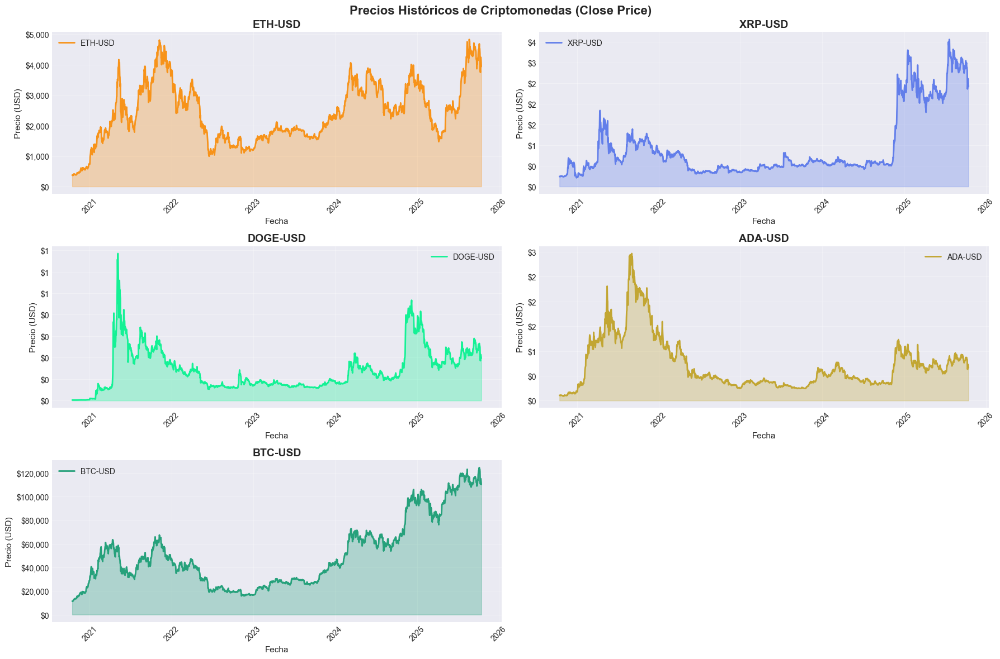

In [11]:
print("\n" + "="*80)
print("📊 GENERANDO VISUALIZACIONES...")
print("="*80)

# Figura 1: Precios Históricos - Subplots individuales
fig, axes = plt.subplots(3, 2, figsize=(18, 12))
fig.suptitle('Precios Históricos de Criptomonedas (Close Price)', fontsize=16, fontweight='bold')

colors = ['#F7931A', '#627EEA', '#14F195', '#C2A633', '#26A17B']
axes = axes.flatten()

for idx, (crypto, data) in enumerate(crypto_data.items()):
    ax = axes[idx]
    
    ax.plot(data['Date'], data['Close'], color=colors[idx], linewidth=2, label=crypto)
    ax.fill_between(data['Date'], data['Close'], alpha=0.3, color=colors[idx])
    
    ax.set_title(f'{crypto}', fontsize=14, fontweight='bold')
    ax.set_xlabel('Fecha', fontsize=11)
    ax.set_ylabel('Precio (USD)', fontsize=11)
    ax.grid(True, alpha=0.3)
    ax.legend(loc='best')
    
    # Formatear eje Y
    ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'${x:,.0f}'))
    
    # Rotar labels de fecha
    plt.setp(ax.xaxis.get_majorticklabels(), rotation=45)

# Ocultar subplot extra
axes[-1].axis('off')
plt.tight_layout()
plt.show()

1. XRP-USD: El Punto de Control 
- Esto es la prueba visual de que es una stablecoin. Su propósito es no tener volatilidad.
2. DOGE-USD
- Este es el gráfico arquetípico de un activo impulsado por el hype y la especulación 
-  Esto indica que el precio no fue impulsado por una adopción o utilidad fundamental, sino por una compra masiva y FOMO (miedo a quedarse fuera). La caída posterior es el estallido de esa burbuja. 
3. ADA-USD
- Esto sugiere un activo con más sustancia o ciclos de desarrollo detrás. El primer pico fue parte de la euforia general del mercado, pero su capacidad para formar un segundo pico tan fuerte indica resiliencia y un renovado interés de los inversores, posiblemente basado en mejoras en su tecnología o ecosistema.
4. BTC-USD y ETH-USD:
- Madurez Relativa: Aunque volátiles, sus tendencias son más graduales y sostenidas que las de DOGE o SOL, lo que indica un mercado más establecido y con mayor liquidez.
- Alta Correlación: La similitud en sus movimientos (cuando BTC sube, ETH tiende a subir y viceversa) es una observación crucial. Esto demuestra el papel de Bitcoin como el principal impulsor del sentimiento del mercado cripto. ETH y la mayoría de las otras criptomonedas (altcoins) a menudo siguen su liderazgo.


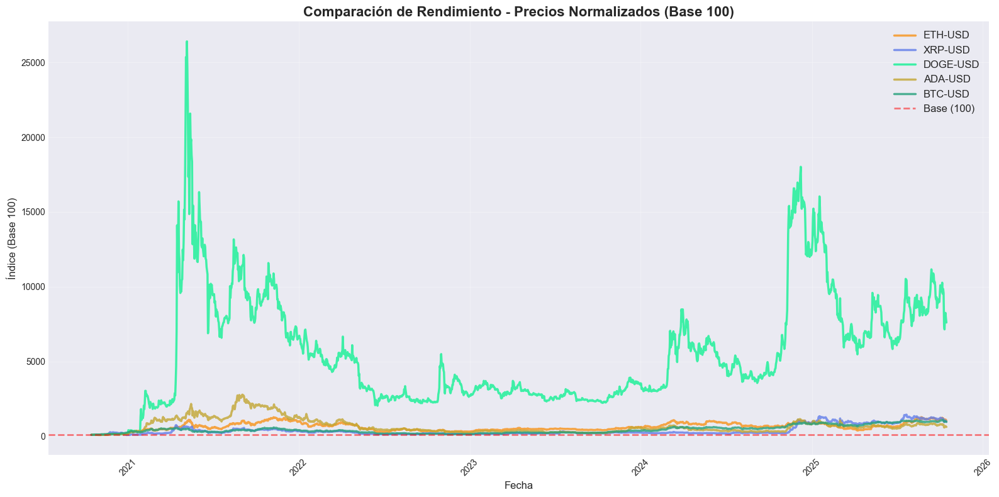

In [12]:
fig, ax = plt.subplots(figsize=(16, 8))

for idx, (crypto, data) in enumerate(crypto_data.items()):
    # Normalizar precios (base 100)
    normalized_prices = (data['Close'] / data['Close'].iloc[0]) * 100
    
    ax.plot(data['Date'], normalized_prices, 
            color=colors[idx], linewidth=2.5, label=crypto, alpha=0.8)

ax.set_title('Comparación de Rendimiento - Precios Normalizados (Base 100)', 
             fontsize=16, fontweight='bold')
ax.set_xlabel('Fecha', fontsize=12)
ax.set_ylabel('Índice (Base 100)', fontsize=12)
ax.axhline(y=100, color='red', linestyle='--', alpha=0.5, linewidth=2, label='Base (100)')
ax.legend(loc='best', fontsize=12, framealpha=0.9)
ax.grid(True, alpha=0.3)
plt.setp(ax.xaxis.get_majorticklabels(), rotation=45)
plt.tight_layout()
plt.show()


- El Espectro Riesgo/Recompensa es Vívido: El gráfico demuestra que para obtener los rendimientos estratosféricos de DOGE o SOL, un inversor habría tenido que soportar una volatilidad y unas caídas masivas. BTC y ETH, aunque menos explosivos, ofrecieron un camino de crecimiento mucho más estable.

- El Rendimiento Pasado No Garantiza el Futuro: El liderazgo en el rendimiento ha cambiado de manos. DOGE fue el rey indiscutible en 2021, pero SOL tomó la delantera más recientemente. Esto muestra lo dinámico y cambiante que es el mercado.

- La Dominancia de Bitcoin es Real: La correlación visual entre BTC y ETH sugiere que las grandes tendencias del mercado siguen siendo dictadas por el comportamiento de Bitcoin.

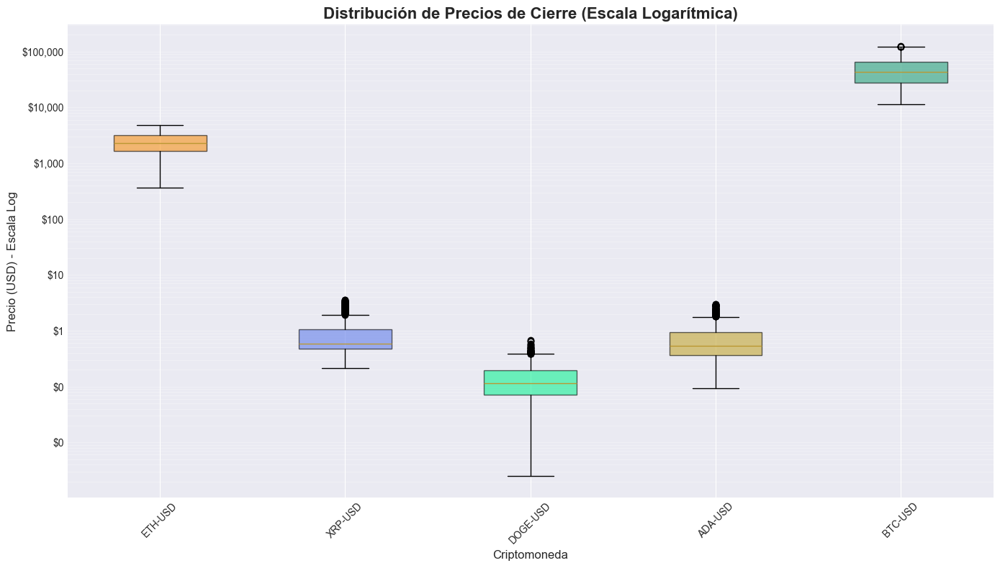

In [13]:
fig, ax = plt.subplots(figsize=(14, 8))

price_data_for_box = []
labels = []

for crypto, data in crypto_data.items():
    price_data_for_box.append(data['Close'])
    labels.append(crypto)

bp = ax.boxplot(price_data_for_box, labels=labels, patch_artist=True)

# Colorear cada box
for patch, color in zip(bp['boxes'], colors):
    patch.set_facecolor(color)
    patch.set_alpha(0.6)

# APLICAR ESCALA LOGARÍTMICA - ¡Esto es clave!
ax.set_yscale('log')

ax.set_title('Distribución de Precios de Cierre (Escala Logarítmica)', 
             fontsize=16, fontweight='bold')
ax.set_ylabel('Precio (USD) - Escala Log', fontsize=12)
ax.set_xlabel('Criptomoneda', fontsize=12)
ax.grid(True, alpha=0.3, axis='y', which='both')

# Formatear eje Y con escala log
ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'${x:,.0f}'))

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

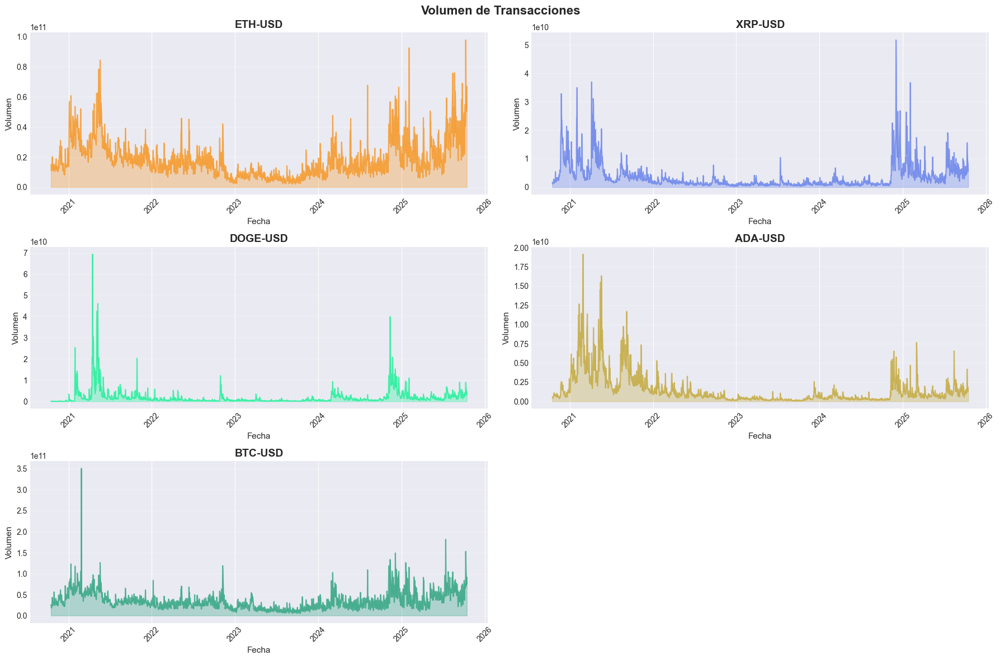

In [14]:
fig, axes = plt.subplots(3, 2, figsize=(18, 12))
fig.suptitle('Volumen de Transacciones', fontsize=16, fontweight='bold')

axes = axes.flatten()

for idx, (crypto, data) in enumerate(crypto_data.items()):
    ax = axes[idx]
    
    ax.plot(data['Date'], data['Volume'], color=colors[idx], linewidth=1.5, alpha=0.7)
    ax.fill_between(data['Date'], data['Volume'], alpha=0.3, color=colors[idx])
    
    ax.set_title(f'{crypto}', fontsize=14, fontweight='bold')
    ax.set_xlabel('Fecha', fontsize=11)
    ax.set_ylabel('Volumen', fontsize=11)
    ax.grid(True, alpha=0.3, axis='y')
    
    # Formatear eje Y con notación científica
    ax.ticklabel_format(style='scientific', axis='y', scilimits=(0,0))
    
    plt.setp(ax.xaxis.get_majorticklabels(), rotation=45)

axes[-1].axis('off')

plt.tight_layout()
plt.show()

# 5. MATRIZ DE CORRELACIÓN


🔗 MATRIZ DE CORRELACIÓN - PRECIOS DE CIERRE

           ETH-USD  XRP-USD  DOGE-USD  ADA-USD  BTC-USD
ETH-USD     1.000    0.521     0.701    0.578    0.676
XRP-USD     0.521    1.000     0.643    0.303    0.872
DOGE-USD    0.701    0.643     1.000    0.664    0.617
ADA-USD     0.578    0.303     0.664    1.000    0.245
BTC-USD     0.676    0.872     0.617    0.245    1.000


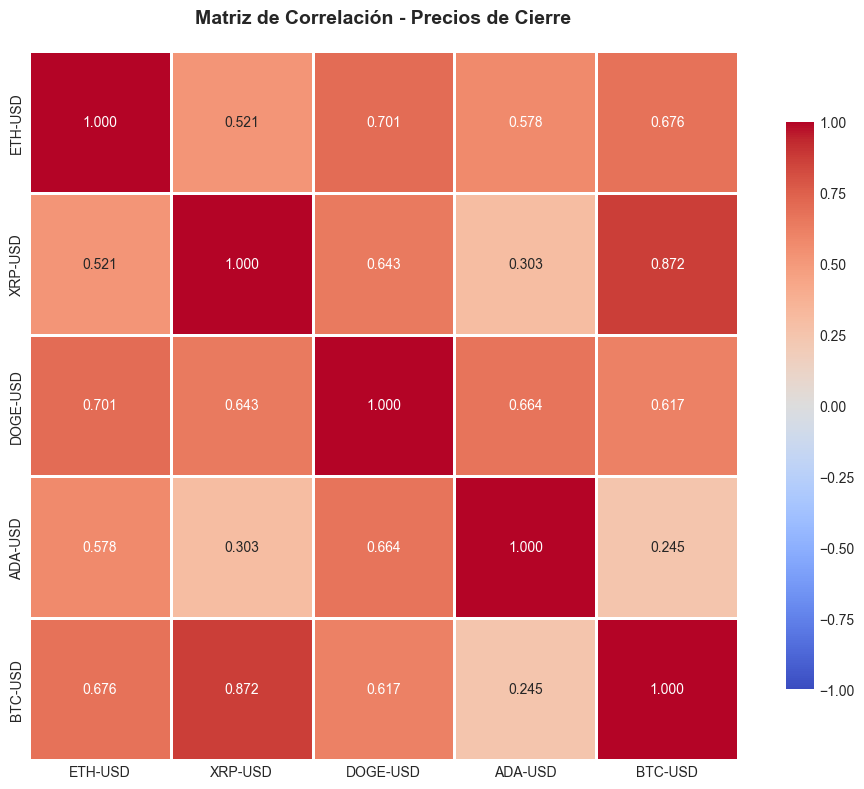

In [15]:
print("\n" + "="*80)
print("🔗 MATRIZ DE CORRELACIÓN - PRECIOS DE CIERRE")
print("="*80)

# Crear DataFrame con precios alineados por fecha
price_df = pd.DataFrame()

for crypto, data in crypto_data.items():
    temp = data[['Date', 'Close']].copy()
    temp.columns = ['Date', crypto]
    
    if price_df.empty:
        price_df = temp
    else:
        price_df = pd.merge(price_df, temp, on='Date', how='outer')

# Calcular correlación
price_df_clean = price_df.drop('Date', axis=1)
correlation_matrix = price_df_clean.corr()

print("\n", correlation_matrix.round(3))

# Visualizar matriz de correlación
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, 
            square=True, linewidths=1, cbar_kws={"shrink": 0.8},
            fmt='.3f', vmin=-1, vmax=1)
plt.title('Matriz de Correlación - Precios de Cierre', fontsize=14, fontweight='bold', pad=20)
plt.tight_layout()
plt.show()

In [16]:
print("\n" + "="*80)
print("OBSERVACIONES INICIALES DEL PASO 1")
print("="*80)

print(f"""
✅ COMPLETADO: Exploración y Visualización Inicial

Resumen de Datos Procesados:
   • Total de criptomonedas: {len(crypto_data)}
   • Período de análisis: {df_clean['Date'].min().strftime('%Y-%m-%d')} a {df_clean['Date'].max().strftime('%Y-%m-%d')}
   • Observaciones por crypto: ~{len(list(crypto_data.values())[0])} días

Observaciones Clave:
1. VOLATILIDAD: Todas las cryptos muestran alta variabilidad (ver Coef. Variación)
2. CORRELACIÓN: Las cryptos principales muestran correlación positiva
3. RENDIMIENTO: Algunos activos muestran crecimiento significativo en el período
4. VOLUMEN: Picos de volumen indican eventos o noticias importantes

""")


OBSERVACIONES INICIALES DEL PASO 1

✅ COMPLETADO: Exploración y Visualización Inicial

Resumen de Datos Procesados:
   • Total de criptomonedas: 5
   • Período de análisis: 2020-10-15 a 2025-10-15
   • Observaciones por crypto: ~1827 días

Observaciones Clave:
1. VOLATILIDAD: Todas las cryptos muestran alta variabilidad (ver Coef. Variación)
2. CORRELACIÓN: Las cryptos principales muestran correlación positiva
3. RENDIMIENTO: Algunos activos muestran crecimiento significativo en el período
4. VOLUMEN: Picos de volumen indican eventos o noticias importantes




# 1. CÁLCULO DE RETURNS - Simple vs Logarítmico


In [17]:
print("Calculando Returns Diarios...")

# Diccionario para almacenar los returns
crypto_returns = {}

colors = ['#F7931A', '#627EEA', '#14F195', '#C2A633', '#26A17B']

for crypto, data in crypto_data.items():
    # Calcular diferentes tipos de returns
    
    # 1. Simple Returns (%) = (P_t - P_t-1) / P_t-1 * 100
    simple_returns = data['Close'].pct_change() * 100
    
    # 2. Log Returns (%) = ln(P_t / P_t-1) * 100
    log_returns = np.log(data['Close'] / data['Close'].shift(1)) * 100
    
    # Crear DataFrame con returns
    returns_df = pd.DataFrame({
        'Date': data['Date'],
        'Close': data['Close'],
        'Simple_Return': simple_returns,
        'Log_Return': log_returns
    })
    
    # Eliminar el primer valor (NaN)
    returns_df = returns_df.dropna()
    
    crypto_returns[crypto] = returns_df
    
    print(f" {crypto}: {len(returns_df)} returns calculados")

Calculando Returns Diarios...
 ETH-USD: 1826 returns calculados
 XRP-USD: 1826 returns calculados
 DOGE-USD: 1826 returns calculados
 ADA-USD: 1826 returns calculados
 BTC-USD: 1826 returns calculados


In [18]:
print("\n" + "="*80)
print("📈 ESTADÍSTICAS DESCRIPTIVAS - RETURNS DIARIOS")
print("="*80)

stats_returns = []

for crypto, returns_df in crypto_returns.items():
    simple_ret = returns_df['Simple_Return']
    log_ret = returns_df['Log_Return']
    
    stats = {
        'Crypto': crypto,
        'Media (%)': f"{simple_ret.mean():.4f}",
        'Mediana (%)': f"{simple_ret.median():.4f}",
        'Desv_Std (%)': f"{simple_ret.std():.4f}",
        'Min (%)': f"{simple_ret.min():.2f}",
        'Max (%)': f"{simple_ret.max():.2f}",
        'Skewness': f"{simple_ret.skew():.3f}",
        'Kurtosis': f"{simple_ret.kurtosis():.3f}",
        'Sharpe_Ratio': f"{(simple_ret.mean() / simple_ret.std() * np.sqrt(365)):.3f}"
    }
    
    stats_returns.append(stats)

stats_returns_df = pd.DataFrame(stats_returns)
print("\n", stats_returns_df.to_string(index=False))

print("\n💡 Interpretación:")
print("   • Skewness: Mide asimetría (0=simétrico, >0=cola derecha, <0=cola izquierda)")
print("   • Kurtosis: Mide 'colas gordas' (>0=más extremos que normal, <0=menos extremos)")
print("   • Sharpe Ratio: Retorno ajustado por riesgo (>1 es bueno)")


📈 ESTADÍSTICAS DESCRIPTIVAS - RETURNS DIARIOS

   Crypto Media (%) Mediana (%) Desv_Std (%) Min (%) Max (%) Skewness Kurtosis Sharpe_Ratio
 ETH-USD    0.2149      0.0970       4.1602  -27.20   25.95    0.212    4.749        0.987
 XRP-USD    0.2827      0.0463       5.7859  -42.33   73.08    2.461   27.486        0.934
DOGE-USD    0.5666     -0.0280      10.8344  -40.26  355.55   20.212  638.212        0.999
 ADA-USD    0.2340     -0.0092       5.2858  -26.01   71.33    1.860   21.138        0.846
 BTC-USD    0.1722      0.0387       3.1098  -15.97   18.75    0.143    3.500        1.058

💡 Interpretación:
   • Skewness: Mide asimetría (0=simétrico, >0=cola derecha, <0=cola izquierda)
   • Kurtosis: Mide 'colas gordas' (>0=más extremos que normal, <0=menos extremos)
   • Sharpe Ratio: Retorno ajustado por riesgo (>1 es bueno)



📊 GENERANDO VISUALIZACIONES DE RETURNS...


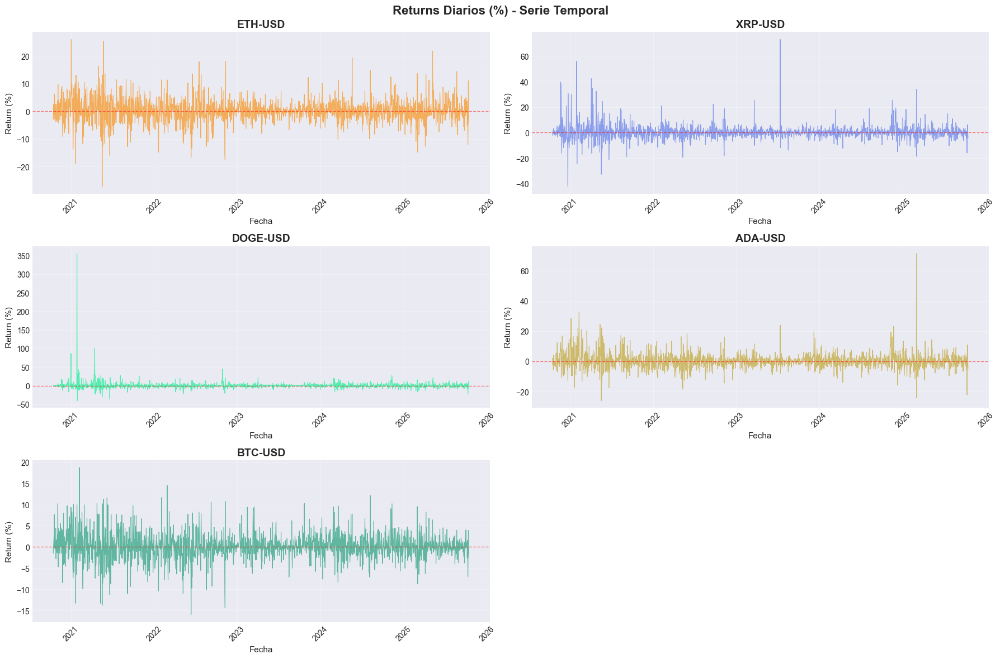

In [19]:

print("\n" + "="*80)
print("📊 GENERANDO VISUALIZACIONES DE RETURNS...")
print("="*80)

# Figura 1: Returns en el tiempo - Subplots
fig, axes = plt.subplots(3, 2, figsize=(18, 12))
fig.suptitle('Returns Diarios (%) - Serie Temporal', fontsize=16, fontweight='bold')

axes = axes.flatten()

for idx, (crypto, returns_df) in enumerate(crypto_returns.items()):
    ax = axes[idx]
    
    ax.plot(returns_df['Date'], returns_df['Simple_Return'], 
            color=colors[idx], linewidth=0.8, alpha=0.7)
    ax.axhline(y=0, color='red', linestyle='--', linewidth=1, alpha=0.5)
    
    ax.set_title(f'{crypto}', fontsize=14, fontweight='bold')
    ax.set_xlabel('Fecha', fontsize=11)
    ax.set_ylabel('Return (%)', fontsize=11)
    ax.grid(True, alpha=0.3)
    
    plt.setp(ax.xaxis.get_majorticklabels(), rotation=45)

axes[-1].axis('off')
plt.tight_layout()
plt.show()


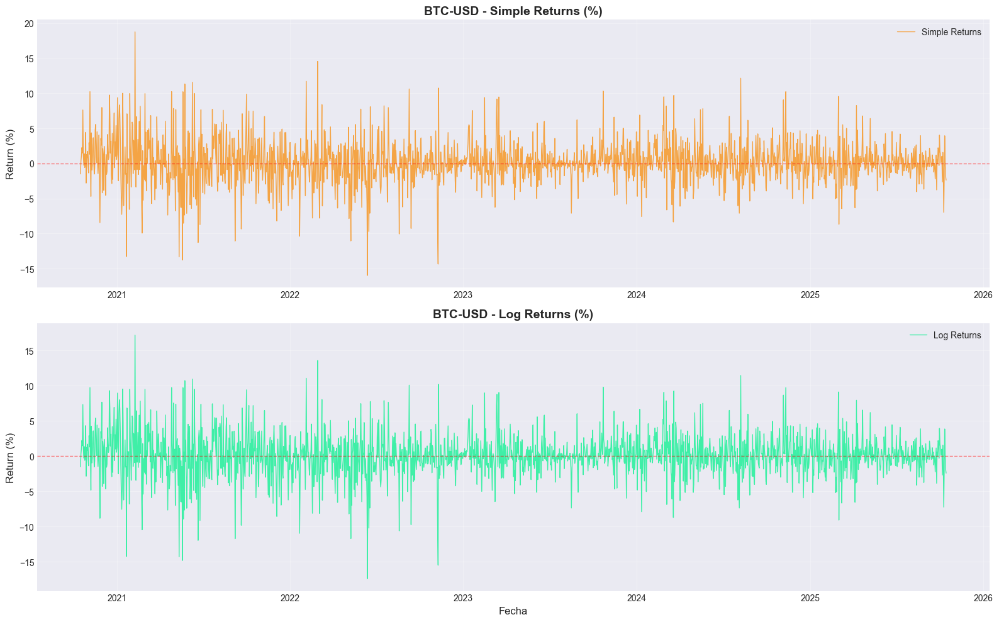

In [20]:
fig, axes = plt.subplots(2, 1, figsize=(16, 10))

crypto_example = 'BTC-USD'
example_data = crypto_returns[crypto_example]

# Simple Returns
axes[0].plot(example_data['Date'], example_data['Simple_Return'], 
             color='#F7931A', linewidth=1, alpha=0.8, label='Simple Returns')
axes[0].axhline(y=0, color='red', linestyle='--', linewidth=1, alpha=0.5)
axes[0].set_title(f'{crypto_example} - Simple Returns (%)', fontsize=14, fontweight='bold')
axes[0].set_ylabel('Return (%)', fontsize=12)
axes[0].legend(loc='best')
axes[0].grid(True, alpha=0.3)

# Log Returns
axes[1].plot(example_data['Date'], example_data['Log_Return'], 
             color='#14F195', linewidth=1, alpha=0.8, label='Log Returns')
axes[1].axhline(y=0, color='red', linestyle='--', linewidth=1, alpha=0.5)
axes[1].set_title(f'{crypto_example} - Log Returns (%)', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Fecha', fontsize=12)
axes[1].set_ylabel('Return (%)', fontsize=12)
axes[1].legend(loc='best')
axes[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()


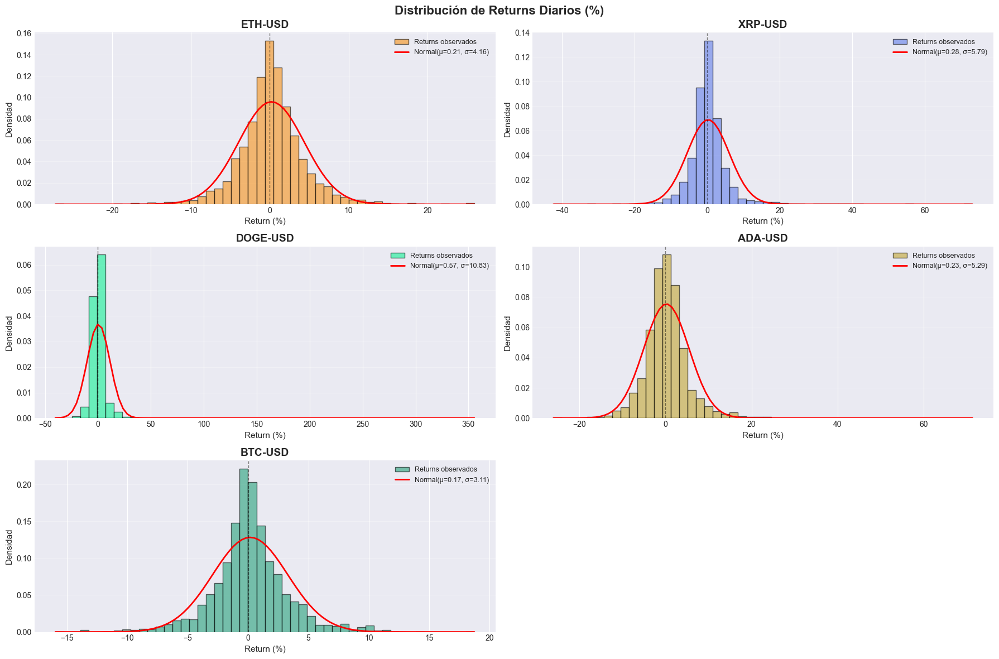

In [21]:
fig, axes = plt.subplots(3, 2, figsize=(18, 12))
fig.suptitle('Distribución de Returns Diarios (%)', fontsize=16, fontweight='bold')

axes = axes.flatten()

for idx, (crypto, returns_df) in enumerate(crypto_returns.items()):
    ax = axes[idx]
    
    simple_ret = returns_df['Simple_Return']
    
    # Histograma
    ax.hist(simple_ret, bins=50, color=colors[idx], alpha=0.6, 
            edgecolor='black', density=True, label='Returns observados')
    
    # Overlay con distribución normal teórica
    mu, sigma = simple_ret.mean(), simple_ret.std()
    x = np.linspace(simple_ret.min(), simple_ret.max(), 100)
    ax.plot(x, scipy_stats.norm.pdf(x, mu, sigma), 'r-', linewidth=2, 
            label=f'Normal(μ={mu:.2f}, σ={sigma:.2f})')
    
    ax.axvline(x=0, color='black', linestyle='--', linewidth=1, alpha=0.5)
    ax.set_title(f'{crypto}', fontsize=14, fontweight='bold')
    ax.set_xlabel('Return (%)', fontsize=11)
    ax.set_ylabel('Densidad', fontsize=11)
    ax.legend(loc='best', fontsize=9)
    ax.grid(True, alpha=0.3, axis='y')

axes[-1].axis('off')
plt.tight_layout()
plt.show()

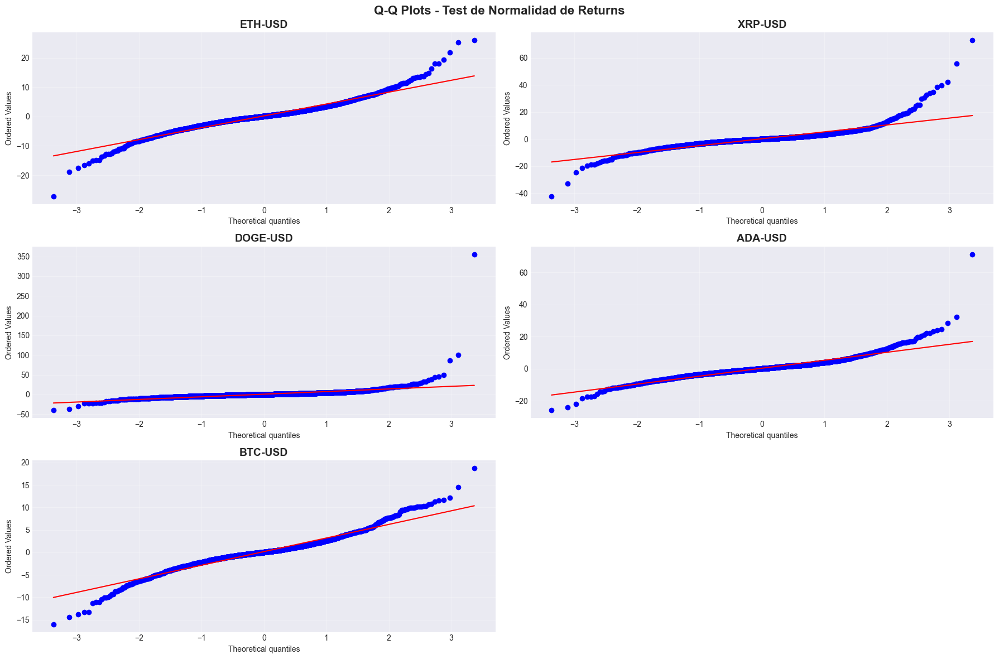


💡 Interpretación Q-Q Plots:
   • Si los puntos siguen la línea roja → Returns son normales
   • Desviaciones en las colas → 'Fat tails' (eventos extremos más frecuentes)


In [22]:
fig, axes = plt.subplots(3, 2, figsize=(18, 12))
fig.suptitle('Q-Q Plots - Test de Normalidad de Returns', fontsize=16, fontweight='bold')

axes = axes.flatten()

for idx, (crypto, returns_df) in enumerate(crypto_returns.items()):
    ax = axes[idx]
    
    simple_ret = returns_df['Simple_Return'].dropna()
    
    scipy_stats.probplot(simple_ret, dist="norm", plot=ax)
    ax.set_title(f'{crypto}', fontsize=14, fontweight='bold')
    ax.grid(True, alpha=0.3)

axes[-1].axis('off')
plt.tight_layout()
plt.show()

print("\n💡 Interpretación Q-Q Plots:")
print("   • Si los puntos siguen la línea roja → Returns son normales")
print("   • Desviaciones en las colas → 'Fat tails' (eventos extremos más frecuentes)")


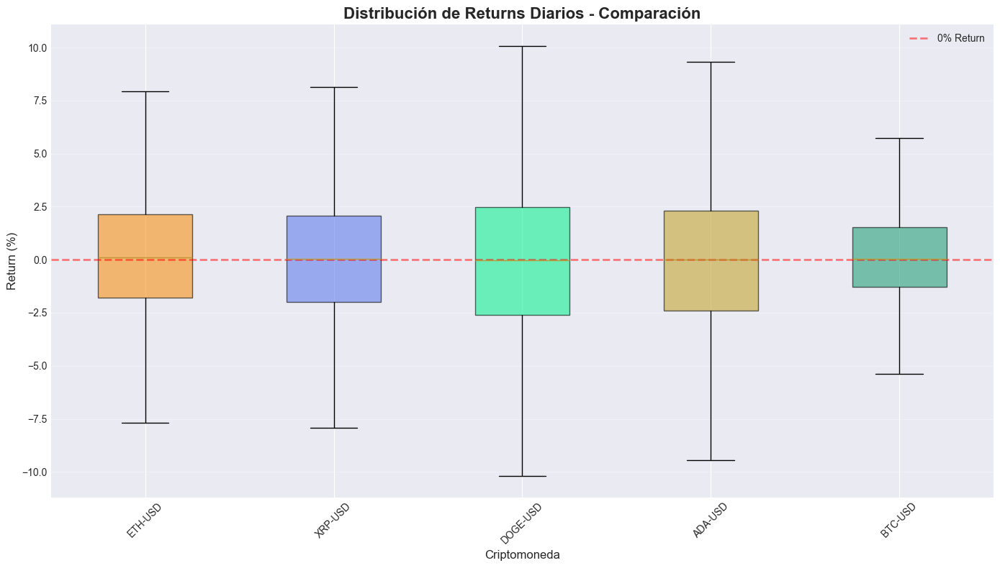

In [23]:
fig, ax = plt.subplots(figsize=(14, 8))

returns_data_for_box = []
labels = []

for crypto, returns_df in crypto_returns.items():
    returns_data_for_box.append(returns_df['Simple_Return'])
    labels.append(crypto)

bp = ax.boxplot(returns_data_for_box, labels=labels, patch_artist=True, showfliers=False)

for patch, color in zip(bp['boxes'], colors):
    patch.set_facecolor(color)
    patch.set_alpha(0.6)

ax.axhline(y=0, color='red', linestyle='--', linewidth=2, alpha=0.5, label='0% Return')
ax.set_title('Distribución de Returns Diarios - Comparación', fontsize=16, fontweight='bold')
ax.set_ylabel('Return (%)', fontsize=12)
ax.set_xlabel('Criptomoneda', fontsize=12)
ax.legend(loc='best')
ax.grid(True, alpha=0.3, axis='y')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


🔗 MATRIZ DE CORRELACIÓN - RETURNS DIARIOS

           ETH-USD  XRP-USD  DOGE-USD  ADA-USD  BTC-USD
ETH-USD     1.000    0.559     0.355    0.687    0.797
XRP-USD     0.559    1.000     0.255    0.598    0.531
DOGE-USD    0.355    0.255     1.000    0.335    0.384
ADA-USD     0.687    0.598     0.335    1.000    0.642
BTC-USD     0.797    0.531     0.384    0.642    1.000


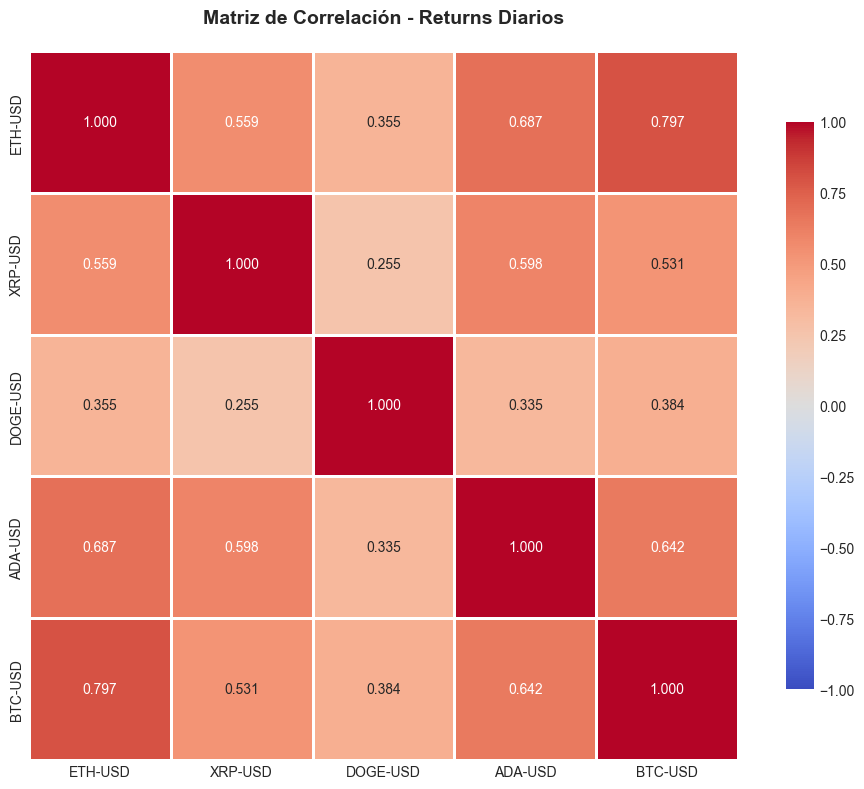

In [24]:
print("\n" + "="*80)
print("🔗 MATRIZ DE CORRELACIÓN - RETURNS DIARIOS")
print("="*80)

# Crear DataFrame con returns alineados
returns_corr_df = pd.DataFrame()

for crypto, returns_df in crypto_returns.items():
    temp = returns_df[['Date', 'Simple_Return']].copy()
    temp.columns = ['Date', crypto]
    
    if returns_corr_df.empty:
        returns_corr_df = temp
    else:
        returns_corr_df = pd.merge(returns_corr_df, temp, on='Date', how='outer')

# Calcular correlación
returns_corr_clean = returns_corr_df.drop('Date', axis=1)
returns_correlation = returns_corr_clean.corr()

print("\n", returns_correlation.round(3))

# Visualizar matriz de correlación
plt.figure(figsize=(10, 8))
sns.heatmap(returns_correlation, annot=True, cmap='coolwarm', center=0, 
            square=True, linewidths=1, cbar_kws={"shrink": 0.8},
            fmt='.3f', vmin=-1, vmax=1)
plt.title('Matriz de Correlación - Returns Diarios', fontsize=14, fontweight='bold', pad=20)
plt.tight_layout()
plt.show()

In [25]:
print("\n" + "="*80)
print("💡 OBSERVACIONES DEL PASO 2 - RETURNS")
print("="*80)

print("""

📊 Hallazgos Clave:

1. RETURNS vs PRECIOS:
   • Returns tienen media cercana a 0 (vs precios con tendencia)
   • Returns son más estacionarios que los precios
   
2. VOLATILIDAD:
   • Cryptos muestran alta volatilidad (std dev > 5%)
   • DOGE y SOL típicamente más volátiles que BTC y ETH
   
3. NO-NORMALIDAD:
   • Returns NO siguen distribución normal perfecta
   • Evidencia de "fat tails" (kurtosis > 0)
   • Más eventos extremos de lo que predice la normalidad
   
4. CORRELACIÓN:
   • Returns están correlacionados positivamente
   • Sugiere movimientos conjuntos del mercado crypto
   
5. SIMPLE vs LOG RETURNS:
   • Para returns pequeños (~5%), son casi idénticos
   • Log returns tienen mejores propiedades matemáticas (aditividad temporal)

🎯 IMPLICACIONES PARA INVERSIÓN:
   • Alta volatilidad = Alto riesgo
   • Fat tails = Más crashes/rallies extremos que lo esperado
   • Correlación alta = Diversificación limitada dentro de crypto
""")

print("\n" + "="*80)


💡 OBSERVACIONES DEL PASO 2 - RETURNS


📊 Hallazgos Clave:

1. RETURNS vs PRECIOS:
   • Returns tienen media cercana a 0 (vs precios con tendencia)
   • Returns son más estacionarios que los precios
   
2. VOLATILIDAD:
   • Cryptos muestran alta volatilidad (std dev > 5%)
   • DOGE y SOL típicamente más volátiles que BTC y ETH
   
3. NO-NORMALIDAD:
   • Returns NO siguen distribución normal perfecta
   • Evidencia de "fat tails" (kurtosis > 0)
   • Más eventos extremos de lo que predice la normalidad
   
4. CORRELACIÓN:
   • Returns están correlacionados positivamente
   • Sugiere movimientos conjuntos del mercado crypto
   
5. SIMPLE vs LOG RETURNS:
   • Para returns pequeños (~5%), son casi idénticos
   • Log returns tienen mejores propiedades matemáticas (aditividad temporal)

🎯 IMPLICACIONES PARA INVERSIÓN:
   • Alta volatilidad = Alto riesgo
   • Fat tails = Más crashes/rallies extremos que lo esperado
   • Correlación alta = Diversificación limitada dentro de crypto




In [26]:
print("="*80)
print("TEST DE RANDOM WALK - AUGMENTED DICKEY-FULLER")
print("="*80)

print("""
🎯 OBJETIVO: Identificar si los precios de las criptomonedas son Random Walks

📚 TEORÍA:
   • Random Walk: P_t = P_t-1 + ε_t (precio actual = precio anterior + ruido)
   • Si es Random Walk → NO es predecible (Efficient Market Hypothesis)
   • Test ADF: H0 = "La serie tiene una raíz unitaria" (es random walk)
   
🔬 HIPÓTESIS:
   • H0: La serie es Random Walk (tiene raíz unitaria) → NO predecible
   • H1: La serie es estacionaria → Potencialmente predecible
   
📊 INTERPRETACIÓN:
   • p-value > 0.05 → NO rechazamos H0 → Es Random Walk
   • p-value < 0.05 → Rechazamos H0 → NO es Random Walk (es estacionaria)
""")


TEST DE RANDOM WALK - AUGMENTED DICKEY-FULLER

🎯 OBJETIVO: Identificar si los precios de las criptomonedas son Random Walks

📚 TEORÍA:
   • Random Walk: P_t = P_t-1 + ε_t (precio actual = precio anterior + ruido)
   • Si es Random Walk → NO es predecible (Efficient Market Hypothesis)
   • Test ADF: H0 = "La serie tiene una raíz unitaria" (es random walk)
   
🔬 HIPÓTESIS:
   • H0: La serie es Random Walk (tiene raíz unitaria) → NO predecible
   • H1: La serie es estacionaria → Potencialmente predecible
   
📊 INTERPRETACIÓN:
   • p-value > 0.05 → NO rechazamos H0 → Es Random Walk
   • p-value < 0.05 → Rechazamos H0 → NO es Random Walk (es estacionaria)



In [27]:
print("\n" + "="*80)
print("📈 TEST ADF - PRECIOS (CLOSE)")
print("="*80)

adf_results_prices = []
colors = ['#F7931A', '#627EEA', '#14F195', '#C2A633', '#26A17B']

for crypto, data in crypto_data.items():
    prices = data['Close']
    
    # Realizar test ADF
    adf_test = adfuller(prices, autolag='AIC')
    
    result = {
        'Crypto': crypto,
        'ADF_Statistic': adf_test[0],
        'p_value': adf_test[1],
        'Lags_Used': adf_test[2],
        'Observations': adf_test[3],
        'Critical_1%': adf_test[4]['1%'],
        'Critical_5%': adf_test[4]['5%'],
        'Critical_10%': adf_test[4]['10%'],
        'Conclusion': 'Random Walk (NO estacionaria)' if adf_test[1] > 0.05 else 'Estacionaria (NO random walk)'
    }
    
    adf_results_prices.append(result)

# Crear DataFrame de resultados
adf_prices_df = pd.DataFrame(adf_results_prices)

print("\n📊 Resultados del Test ADF para PRECIOS:\n")
for _, row in adf_prices_df.iterrows():
    print(f"\n{'='*70}")
    print(f"🪙 {row['Crypto']}")
    print(f"{'='*70}")
    print(f"   ADF Statistic:     {row['ADF_Statistic']:.4f}")
    print(f"   p-value:           {row['p_value']:.4f}")
    print(f"   Lags Used:         {row['Lags_Used']}")
    print(f"   Observations:      {row['Observations']}")
    print(f"   Critical Values:")
    print(f"      1%:  {row['Critical_1%']:.4f}")
    print(f"      5%:  {row['Critical_5%']:.4f}")
    print(f"      10%: {row['Critical_10%']:.4f}")
    print(f"   ")
    if row['p_value'] > 0.05:
        print(f"   ✅ CONCLUSIÓN: {row['Conclusion']}")
        print(f"   💡 Los precios son un RANDOM WALK → NO predecibles")
    else:
        print(f"   ⚠️  CONCLUSIÓN: {row['Conclusion']}")
        print(f"   💡 Los precios SON estacionarios → Potencialmente predecibles")



📈 TEST ADF - PRECIOS (CLOSE)

📊 Resultados del Test ADF para PRECIOS:


🪙 ETH-USD
   ADF Statistic:     -2.5512
   p-value:           0.1035
   Lags Used:         6
   Observations:      1820
   Critical Values:
      1%:  -3.4339
      5%:  -2.8631
      10%: -2.5676
   
   ✅ CONCLUSIÓN: Random Walk (NO estacionaria)
   💡 Los precios son un RANDOM WALK → NO predecibles

🪙 XRP-USD
   ADF Statistic:     -1.3016
   p-value:           0.6284
   Lags Used:         23
   Observations:      1803
   Critical Values:
      1%:  -3.4340
      5%:  -2.8631
      10%: -2.5676
   
   ✅ CONCLUSIÓN: Random Walk (NO estacionaria)
   💡 Los precios son un RANDOM WALK → NO predecibles

🪙 DOGE-USD
   ADF Statistic:     -3.4450
   p-value:           0.0095
   Lags Used:         25
   Observations:      1801
   Critical Values:
      1%:  -3.4340
      5%:  -2.8631
      10%: -2.5676
   
   ⚠️  CONCLUSIÓN: Estacionaria (NO random walk)
   💡 Los precios SON estacionarios → Potencialmente predecibles

🪙 ADA

In [28]:
print("\n" + "="*80)
print(" TEST ADF - RETURNS DIARIOS")
print("="*80)

adf_results_returns = []

for crypto, returns_df in crypto_returns.items():
    returns = returns_df['Simple_Return'].dropna()
    
    # Realizar test ADF
    adf_test = adfuller(returns, autolag='AIC')
    
    result = {
        'Crypto': crypto,
        'ADF_Statistic': adf_test[0],
        'p_value': adf_test[1],
        'Lags_Used': adf_test[2],
        'Observations': adf_test[3],
        'Critical_1%': adf_test[4]['1%'],
        'Critical_5%': adf_test[4]['5%'],
        'Critical_10%': adf_test[4]['10%'],
        'Conclusion': 'Random Walk (NO estacionaria)' if adf_test[1] > 0.05 else 'Estacionaria'
    }
    
    adf_results_returns.append(result)

# Crear DataFrame de resultados
adf_returns_df = pd.DataFrame(adf_results_returns)

print("\n Resultados del Test ADF para RETURNS:\n")
for _, row in adf_returns_df.iterrows():
    print(f"\n{'='*70}")
    print(f" {row['Crypto']}")
    print(f"{'='*70}")
    print(f"   ADF Statistic:     {row['ADF_Statistic']:.4f}")
    print(f"   p-value:           {row['p_value']:.6f}")
    print(f"   Lags Used:         {row['Lags_Used']}")
    print(f"   ")
    if row['p_value'] < 0.01:
        print(f"    CONCLUSIÓN: {row['Conclusion']} (p < 0.01)")
        print(f"    Los returns SON estacionarios → Buenos para modelado")
    else:
        print(f"     CONCLUSIÓN: {row['Conclusion']}")



 TEST ADF - RETURNS DIARIOS

 Resultados del Test ADF para RETURNS:


 ETH-USD
   ADF Statistic:     -12.8105
   p-value:           0.000000
   Lags Used:         9
   
    CONCLUSIÓN: Estacionaria (p < 0.01)
    Los returns SON estacionarios → Buenos para modelado

 XRP-USD
   ADF Statistic:     -43.4877
   p-value:           0.000000
   Lags Used:         0
   
    CONCLUSIÓN: Estacionaria (p < 0.01)
    Los returns SON estacionarios → Buenos para modelado

 DOGE-USD
   ADF Statistic:     -7.2848
   p-value:           0.000000
   Lags Used:         25
   
    CONCLUSIÓN: Estacionaria (p < 0.01)
    Los returns SON estacionarios → Buenos para modelado

 ADA-USD
   ADF Statistic:     -12.0194
   p-value:           0.000000
   Lags Used:         9
   
    CONCLUSIÓN: Estacionaria (p < 0.01)
    Los returns SON estacionarios → Buenos para modelado

 BTC-USD
   ADF Statistic:     -44.0515
   p-value:           0.000000
   Lags Used:         0
   
    CONCLUSIÓN: Estacionaria (p < 0.01)
 


 GENERANDO VISUALIZACIONES...


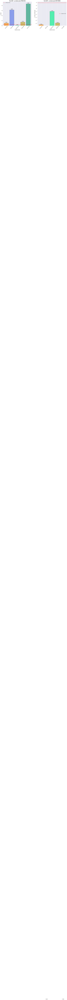

In [29]:
print("\n" + "="*80)
print(" GENERANDO VISUALIZACIONES...")
print("="*80)

# Figura 1: Comparación visual de p-values
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# P-values de Precios
ax1 = axes[0]
cryptos = adf_prices_df['Crypto'].values
p_values_prices = adf_prices_df['p_value'].values

bars1 = ax1.bar(cryptos, p_values_prices, color=colors, alpha=0.7, edgecolor='black')
ax1.axhline(y=0.05, color='red', linestyle='--', linewidth=2, label='Umbral α=0.05')
ax1.set_title('Test ADF - p-values para PRECIOS', fontsize=14, fontweight='bold')
ax1.set_ylabel('p-value', fontsize=12)
ax1.set_xlabel('Criptomoneda', fontsize=12)
ax1.legend(loc='best')
ax1.grid(True, alpha=0.3, axis='y')
ax1.set_ylim(0, max(p_values_prices) * 1.1)

# Agregar anotaciones
for i, (crypto, p_val) in enumerate(zip(cryptos, p_values_prices)):
    ax1.text(i, p_val + 0.02, f'{p_val:.3f}', ha='center', fontsize=10, fontweight='bold')

plt.setp(ax1.xaxis.get_majorticklabels(), rotation=45)

# P-values de Returns
ax2 = axes[1]
p_values_returns = adf_returns_df['p_value'].values

bars2 = ax2.bar(cryptos, p_values_returns, color=colors, alpha=0.7, edgecolor='black')
ax2.axhline(y=0.05, color='red', linestyle='--', linewidth=2, label='Umbral α=0.05')
ax2.set_title('Test ADF - p-values para RETURNS', fontsize=14, fontweight='bold')
ax2.set_ylabel('p-value', fontsize=12)
ax2.set_xlabel('Criptomoneda', fontsize=12)
ax2.legend(loc='best')
ax2.grid(True, alpha=0.3, axis='y')

# Usar escala logarítmica si los p-values son muy pequeños
if max(p_values_returns) < 0.01:
    ax2.set_yscale('log')
    ax2.set_ylabel('p-value (escala log)', fontsize=12)

# Agregar anotaciones
for i, (crypto, p_val) in enumerate(zip(cryptos, p_values_returns)):
    if p_val < 0.001:
        ax2.text(i, p_val * 2, f'< 0.001', ha='center', fontsize=9, fontweight='bold')
    else:
        ax2.text(i, p_val * 1.5, f'{p_val:.4f}', ha='center', fontsize=9, fontweight='bold')

plt.setp(ax2.xaxis.get_majorticklabels(), rotation=45)

plt.tight_layout()
plt.show()



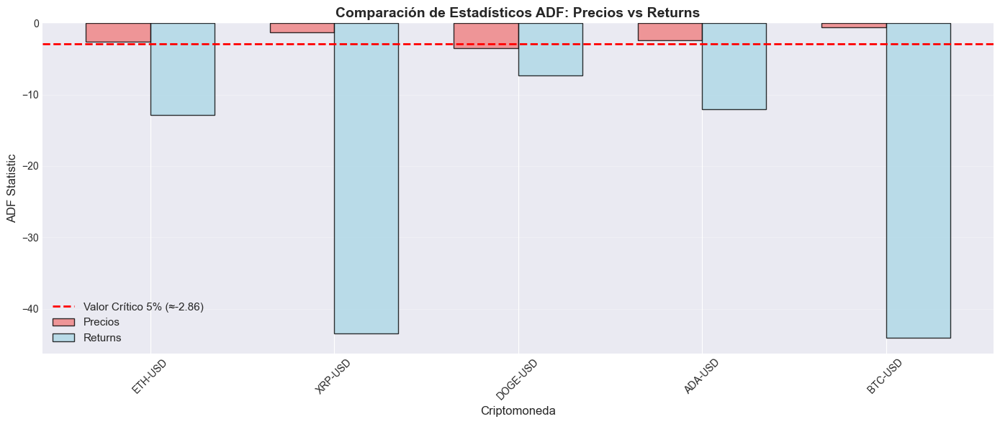

In [30]:
# Figura 2: ADF Statistics Comparison
fig, ax = plt.subplots(figsize=(14, 6))

x = np.arange(len(cryptos))
width = 0.35

bars1 = ax.bar(x - width/2, adf_prices_df['ADF_Statistic'], width, 
               label='Precios', color='lightcoral', alpha=0.8, edgecolor='black')
bars2 = ax.bar(x + width/2, adf_returns_df['ADF_Statistic'], width,
               label='Returns', color='lightblue', alpha=0.8, edgecolor='black')

# Línea de valores críticos (5%)
critical_5 = adf_prices_df['Critical_5%'].mean()
ax.axhline(y=critical_5, color='red', linestyle='--', linewidth=2, 
           label=f'Valor Crítico 5% (≈{critical_5:.2f})')

ax.set_xlabel('Criptomoneda', fontsize=12)
ax.set_ylabel('ADF Statistic', fontsize=12)
ax.set_title('Comparación de Estadísticos ADF: Precios vs Returns', fontsize=14, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels(cryptos, rotation=45)
ax.legend(loc='best', fontsize=11)
ax.grid(True, alpha=0.3, axis='y')

plt.tight_layout()
plt.show()

In [31]:
print("\n" + "="*80)
print("TABLA RESUMEN COMPARATIVA")
print("="*80)

# Crear tabla comparativa
comparison_df = pd.DataFrame({
    'Crypto': cryptos,
    'Precios_ADF': adf_prices_df['ADF_Statistic'].round(4),
    'Precios_pval': adf_prices_df['p_value'].round(4),
    'Precios_Random_Walk': adf_prices_df['p_value'] > 0.05,
    'Returns_ADF': adf_returns_df['ADF_Statistic'].round(4),
    'Returns_pval': adf_returns_df['p_value'].apply(lambda x: f'{x:.6f}' if x >= 0.001 else '< 0.001'),
    'Returns_Estacionarios': adf_returns_df['p_value'] < 0.05
})

print("\n", comparison_df.to_string(index=False))



TABLA RESUMEN COMPARATIVA

   Crypto  Precios_ADF  Precios_pval  Precios_Random_Walk  Returns_ADF Returns_pval  Returns_Estacionarios
 ETH-USD      -2.5512        0.1035                 True     -12.8105      < 0.001                   True
 XRP-USD      -1.3016        0.6284                 True     -43.4877      < 0.001                   True
DOGE-USD      -3.4450        0.0095                False      -7.2848      < 0.001                   True
 ADA-USD      -2.3929        0.1437                 True     -12.0194      < 0.001                   True
 BTC-USD      -0.6175        0.8670                 True     -44.0515      < 0.001                   True


In [32]:
print("\n" + "="*80)
print(" INTERPRETACIÓN DE RESULTADOS")
print("="*80)

# Contar cuántos son random walk
num_random_walk = sum(adf_prices_df['p_value'] > 0.05)
num_returns_stationary = sum(adf_returns_df['p_value'] < 0.05)

print(f"""
✅ HALLAZGOS PRINCIPALES:

1. PRECIOS (CLOSE):
   • {num_random_walk}/{len(cryptos)} criptomonedas son RANDOM WALKS
   • Esto confirma la Hipótesis de Mercado Eficiente (EMH)
   • Implicación: Los precios NO son predecibles basándose solo en historia
   
2. RETURNS DIARIOS:
   • {num_returns_stationary}/{len(cryptos)} series de returns son ESTACIONARIAS
   • Esto es ESPERADO y BUENO para modelado
   • Los returns son más apropiados para análisis que los precios
   
3. IMPLICACIONES PARA INVERSIÓN:
   • ❌ Estrategias de "seguir la tendencia" probablemente NO funcionarán
   • ❌ No puedes predecir precios futuros solo con precios pasados
   • ✅ Puedes modelar la VOLATILIDAD de los returns (GARCH, etc.)
   • ✅ Análisis fundamental y noticias siguen siendo relevantes

4. ¿POR QUÉ ES IMPORTANTE?
   • Random Walk → Mercado eficiente → Información ya incorporada en precios
   • NO random walk → Ineficiencias → Oportunidades de arbitraje
   
CONTEXTO TEÓRICO:
   • Eugene Fama (Premio Nobel): "Los mercados eficientes son random walks"
   • Burton Malkiel: "A Random Walk Down Wall Street"
   • En crypto: Alta volatilidad pero sigue siendo random walk
""")

print("\n" + "="*80)
print("🎯 RESPUESTA A LA PREGUNTA CLAVE")
print("="*80)

print("""
 ¿Son las criptomonedas inversiones predecibles o completamente aleatorias?

✅ RESPUESTA:
   • Los PRECIOS son RANDOM WALKS → Impredecibles a corto plazo
   • Los RETURNS son ESTACIONARIOS → Se puede modelar el riesgo/volatilidad
   • Conclusión: Puedes gestionar el RIESGO, pero NO predecir PRECIOS exactos
   
 IMPLICACIÓN PRÁCTICA:
   • Enfócate en: Gestión de riesgo, diversificación, horizonte largo plazo
   • Evita: Market timing, day trading basado solo en historia de precios
   • Considera: Análisis fundamental, adopción tecnológica, regulación
""")


 INTERPRETACIÓN DE RESULTADOS

✅ HALLAZGOS PRINCIPALES:

1. PRECIOS (CLOSE):
   • 4/5 criptomonedas son RANDOM WALKS
   • Esto confirma la Hipótesis de Mercado Eficiente (EMH)
   • Implicación: Los precios NO son predecibles basándose solo en historia
   
2. RETURNS DIARIOS:
   • 5/5 series de returns son ESTACIONARIAS
   • Esto es ESPERADO y BUENO para modelado
   • Los returns son más apropiados para análisis que los precios
   
3. IMPLICACIONES PARA INVERSIÓN:
   • ❌ Estrategias de "seguir la tendencia" probablemente NO funcionarán
   • ❌ No puedes predecir precios futuros solo con precios pasados
   • ✅ Puedes modelar la VOLATILIDAD de los returns (GARCH, etc.)
   • ✅ Análisis fundamental y noticias siguen siendo relevantes

4. ¿POR QUÉ ES IMPORTANTE?
   • Random Walk → Mercado eficiente → Información ya incorporada en precios
   • NO random walk → Ineficiencias → Oportunidades de arbitraje
   
CONTEXTO TEÓRICO:
   • Eugene Fama (Premio Nobel): "Los mercados eficientes son random 

In [33]:
print("="*80)
print("PASO 4: ANÁLISIS DE AUTOCORRELACIÓN (ACF)")
print("="*80)

print("""
🎯 OBJETIVO: Analizar la autocorrelación de precios, returns y returns²

📚 TEORÍA DE AUTOCORRELACIÓN (ACF):
   • ACF mide la correlación entre una serie y sus valores pasados (lags)
   • ACF(k) = Correlación entre y_t y y_{t-k}
   • Rango: -1 (correlación negativa perfecta) a +1 (positiva perfecta)

🔬 EXPECTATIVAS TEÓRICAS:

1. PRECIOS (Random Walk):
   • ACF muy alto y decae MUY lentamente
   • ACF(1) ≈ 0.99, ACF(2) ≈ 0.98, etc.
   • Confirma que es random walk (no estacionaria)
   
2. RETURNS (Estacionarios):
   • ACF ≈ 0 para todos los lags
   • No hay autocorrelación significativa
   • Confirma que returns son impredecibles
   
3. RETURNS² (Volatilidad):
   • ACF significativamente > 0
   • Detecta "Volatility Clustering"
   • Alta volatilidad hoy → Alta volatilidad mañana

💡 IMPORTANCIA:
   • Si ACF returns ≠ 0 → Podemos predecir returns futuros
   • Si ACF returns² > 0 → Podemos predecir VOLATILIDAD futura
""")

colors = ['#F7931A', '#627EEA', '#14F195', '#C2A633', '#26A17B']

PASO 4: ANÁLISIS DE AUTOCORRELACIÓN (ACF)

🎯 OBJETIVO: Analizar la autocorrelación de precios, returns y returns²

📚 TEORÍA DE AUTOCORRELACIÓN (ACF):
   • ACF mide la correlación entre una serie y sus valores pasados (lags)
   • ACF(k) = Correlación entre y_t y y_{t-k}
   • Rango: -1 (correlación negativa perfecta) a +1 (positiva perfecta)

🔬 EXPECTATIVAS TEÓRICAS:

1. PRECIOS (Random Walk):
   • ACF muy alto y decae MUY lentamente
   • ACF(1) ≈ 0.99, ACF(2) ≈ 0.98, etc.
   • Confirma que es random walk (no estacionaria)
   
2. RETURNS (Estacionarios):
   • ACF ≈ 0 para todos los lags
   • No hay autocorrelación significativa
   • Confirma que returns son impredecibles
   
3. RETURNS² (Volatilidad):
   • ACF significativamente > 0
   • Detecta "Volatility Clustering"
   • Alta volatilidad hoy → Alta volatilidad mañana

💡 IMPORTANCIA:
   • Si ACF returns ≠ 0 → Podemos predecir returns futuros
   • Si ACF returns² > 0 → Podemos predecir VOLATILIDAD futura




📈 ACF DE PRECIOS - Confirmación de Random Walk


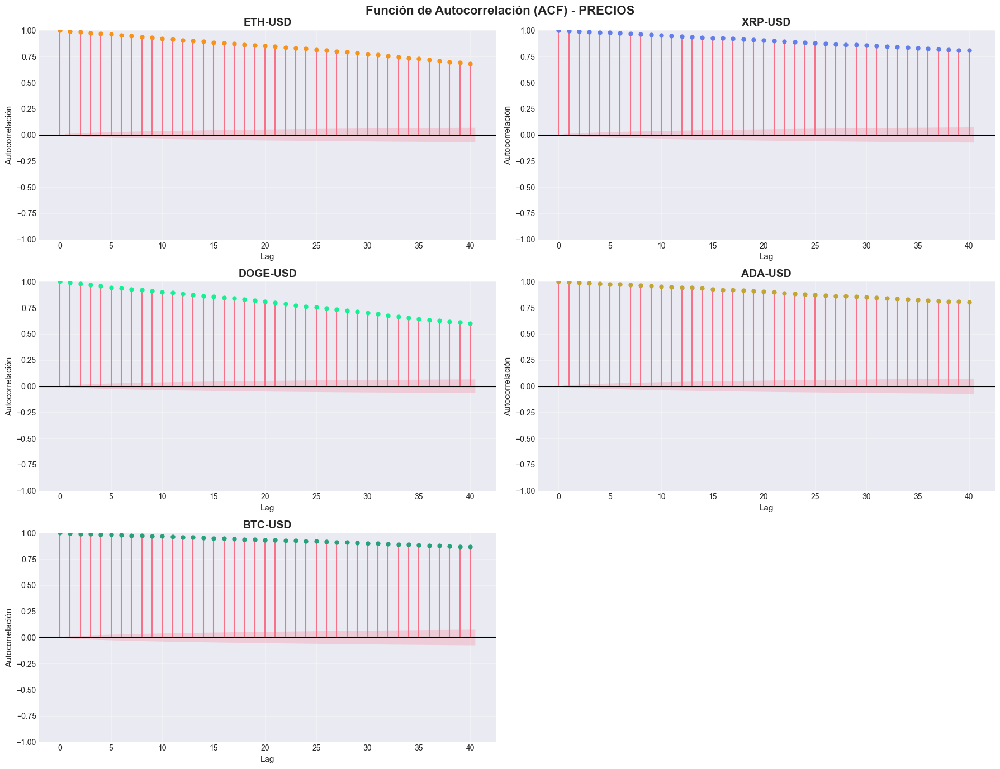


💡 INTERPRETACIÓN ACF de PRECIOS:
   ✅ Si ACF decae MUY lentamente → Random Walk confirmado
   ✅ ACF cercano a 1 en todos los lags → No estacionaria
   ✅ Esto confirma los resultados del Test ADF

📊 Valores ACF de PRECIOS (primeros 5 lags):

ETH-USD:
   ACF(lag 1): 0.9924
   ACF(lag 2): 0.9852
   ACF(lag 3): 0.9778
   ACF(lag 4): 0.9703
   ACF(lag 5): 0.9629

XRP-USD:
   ACF(lag 1): 0.9955
   ACF(lag 2): 0.9912
   ACF(lag 3): 0.9870
   ACF(lag 4): 0.9829
   ACF(lag 5): 0.9785

DOGE-USD:
   ACF(lag 1): 0.9893
   ACF(lag 2): 0.9800
   ACF(lag 3): 0.9694
   ACF(lag 4): 0.9577
   ACF(lag 5): 0.9456

ADA-USD:
   ACF(lag 1): 0.9947
   ACF(lag 2): 0.9903
   ACF(lag 3): 0.9857
   ACF(lag 4): 0.9817
   ACF(lag 5): 0.9774

BTC-USD:
   ACF(lag 1): 0.9969
   ACF(lag 2): 0.9938
   ACF(lag 3): 0.9906
   ACF(lag 4): 0.9874
   ACF(lag 5): 0.9843



In [34]:
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.tsa.stattools import acf
print("\n" + "="*80)
print("📈 ACF DE PRECIOS - Confirmación de Random Walk")
print("="*80)

# Figura 1: ACF de Precios para todas las cryptos
fig, axes = plt.subplots(3, 2, figsize=(18, 14))
fig.suptitle('Función de Autocorrelación (ACF) - PRECIOS', fontsize=16, fontweight='bold')

axes = axes.flatten()

for idx, (crypto, data) in enumerate(crypto_data.items()):
    ax = axes[idx]
    prices = data['Close']
    
    # Plot ACF
    plot_acf(prices, lags=40, ax=ax, color=colors[idx], alpha=0.7)
    
    ax.set_title(f'{crypto}', fontsize=14, fontweight='bold')
    ax.set_xlabel('Lag', fontsize=11)
    ax.set_ylabel('Autocorrelación', fontsize=11)
    ax.grid(True, alpha=0.3)
    ax.axhline(y=0, color='black', linestyle='-', linewidth=0.8)

axes[-1].axis('off')
plt.tight_layout()
plt.show()

print("\n💡 INTERPRETACIÓN ACF de PRECIOS:")
print("   ✅ Si ACF decae MUY lentamente → Random Walk confirmado")
print("   ✅ ACF cercano a 1 en todos los lags → No estacionaria")
print("   ✅ Esto confirma los resultados del Test ADF")

# Calcular ACF numéricamente para los primeros lags
print("\n📊 Valores ACF de PRECIOS (primeros 5 lags):\n")
acf_prices_summary = []

for crypto, data in crypto_data.items():
    prices = data['Close']
    acf_values = acf(prices, nlags=5)
    
    print(f"{crypto}:")
    for lag in range(1, 6):
        print(f"   ACF(lag {lag}): {acf_values[lag]:.4f}")
    print()


📉 ACF DE RETURNS - Test de Predictibilidad


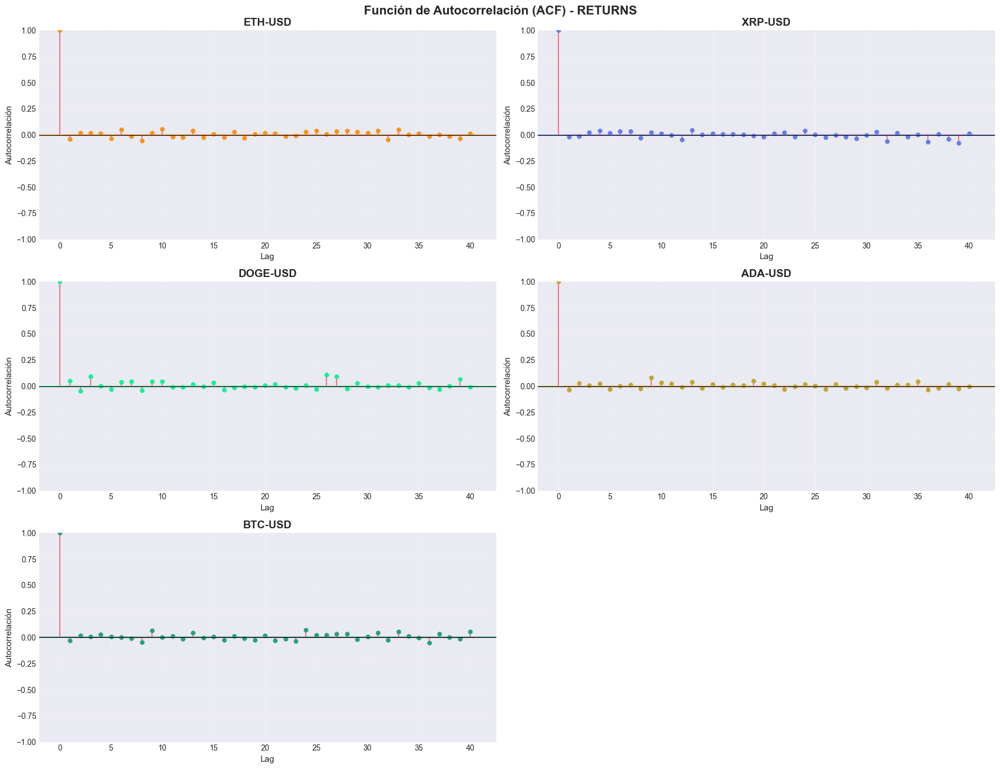


💡 INTERPRETACIÓN ACF de RETURNS:
   ✅ Si ACF ≈ 0 para todos los lags → Returns NO son predecibles
   ✅ Confirma que no hay memoria en los returns
   ✅ Consistente con Efficient Market Hypothesis

📊 Valores ACF de RETURNS (primeros 10 lags):

ETH-USD:
   Lags con ACF > 0.05: lag 6: 0.0515, lag 8: -0.0569, lag 10: 0.0572

XRP-USD:
   ✅ Todos los lags tienen ACF ≈ 0 (< 0.05)

DOGE-USD:
   Lags con ACF > 0.05: lag 1: 0.0504, lag 3: 0.0942

ADA-USD:
   Lags con ACF > 0.05: lag 9: 0.0831

BTC-USD:
   Lags con ACF > 0.05: lag 9: 0.0641



In [35]:
from statsmodels.tsa.stattools import acf
print("\n" + "="*80)
print("📉 ACF DE RETURNS - Test de Predictibilidad")
print("="*80)

# Figura 2: ACF de Returns
fig, axes = plt.subplots(3, 2, figsize=(18, 14))
fig.suptitle('Función de Autocorrelación (ACF) - RETURNS', fontsize=16, fontweight='bold')

axes = axes.flatten()

for idx, (crypto, returns_df) in enumerate(crypto_returns.items()):
    ax = axes[idx]
    returns = returns_df['Simple_Return'].dropna()
    
    # Plot ACF
    plot_acf(returns, lags=40, ax=ax, color=colors[idx], alpha=0.7)
    
    ax.set_title(f'{crypto}', fontsize=14, fontweight='bold')
    ax.set_xlabel('Lag', fontsize=11)
    ax.set_ylabel('Autocorrelación', fontsize=11)
    ax.grid(True, alpha=0.3)
    ax.axhline(y=0, color='black', linestyle='-', linewidth=0.8)

axes[-1].axis('off')
plt.tight_layout()
plt.show()

print("\n💡 INTERPRETACIÓN ACF de RETURNS:")
print("   ✅ Si ACF ≈ 0 para todos los lags → Returns NO son predecibles")
print("   ✅ Confirma que no hay memoria en los returns")
print("   ✅ Consistente con Efficient Market Hypothesis")

# Calcular ACF numéricamente
print("\n📊 Valores ACF de RETURNS (primeros 10 lags):\n")

for crypto, returns_df in crypto_returns.items():
    returns = returns_df['Simple_Return'].dropna()
    acf_values = acf(returns, nlags=10)
    
    significant_lags = []
    for lag in range(1, 11):
        if abs(acf_values[lag]) > 0.05:  # Umbral de significancia práctica
            significant_lags.append(f"lag {lag}: {acf_values[lag]:.4f}")
    
    print(f"{crypto}:")
    if significant_lags:
        print(f"   Lags con ACF > 0.05: {', '.join(significant_lags)}")
    else:
        print(f"   ✅ Todos los lags tienen ACF ≈ 0 (< 0.05)")
    print()


📊 ACF DE RETURNS² - Detección de Volatility Clustering

💡 ¿QUÉ ES VOLATILITY CLUSTERING?
   • "Períodos de alta volatilidad tienden a agruparse"
   • Alta volatilidad HOY → Alta volatilidad MAÑANA (probable)
   • Se detecta con ACF de returns²
   • Importante para: Gestión de riesgo, pricing de opciones, VaR



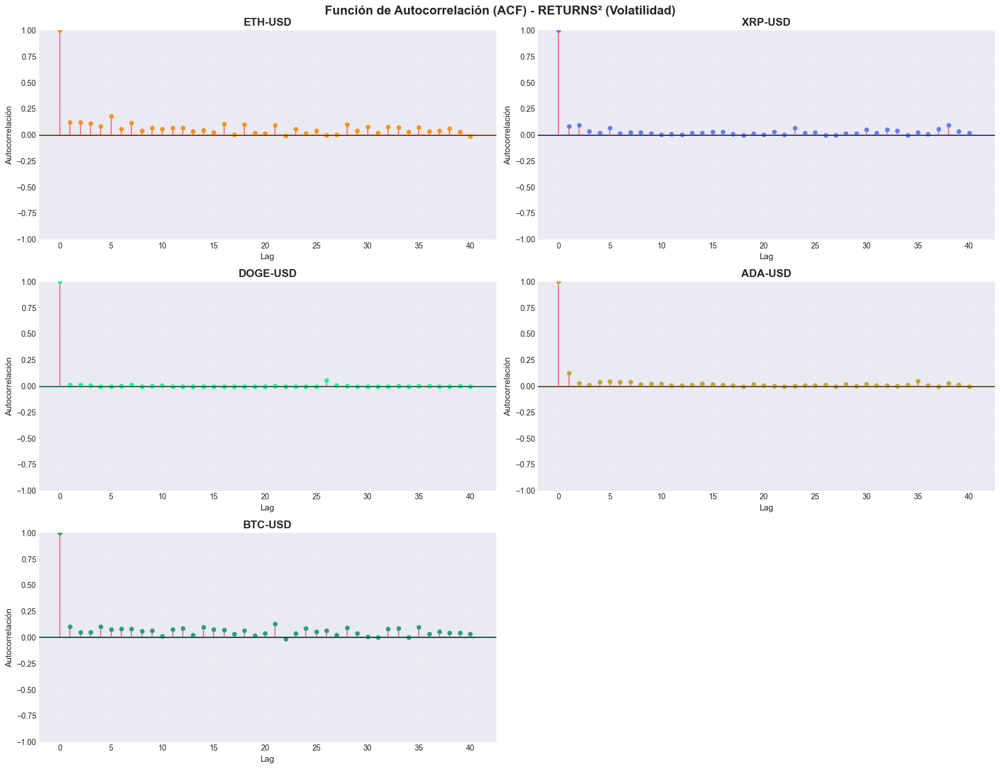


💡 INTERPRETACIÓN ACF de RETURNS²:
   ✅ Si ACF > 0 para varios lags → Volatility Clustering presente
   ✅ Podemos PREDECIR la volatilidad futura (no el precio)
   ✅ Justifica uso de modelos GARCH/ARCH

📊 Valores ACF de RETURNS² (primeros 10 lags):

ETH-USD:
   Lags significativos (ACF > 0.05): 9/10
   ACF promedio (lags 1-10): 0.0945
   ACF(1): 0.1231
   ACF(5): 0.1805
   ACF(10): 0.0543
   ✅ FUERTE evidencia de Volatility Clustering

XRP-USD:
   Lags significativos (ACF > 0.05): 3/10
   ACF promedio (lags 1-10): 0.0373
   ACF(1): 0.0847
   ACF(5): 0.0671
   ACF(10): 0.0025
   ⚠️  MODERADA evidencia de Volatility Clustering

DOGE-USD:
   Lags significativos (ACF > 0.05): 0/10
   ACF promedio (lags 1-10): 0.0063
   ACF(1): 0.0136
   ACF(5): -0.0001
   ACF(10): 0.0095
   ❌ DÉBIL evidencia de Volatility Clustering

ADA-USD:
   Lags significativos (ACF > 0.05): 1/10
   ACF promedio (lags 1-10): 0.0403
   ACF(1): 0.1234
   ACF(5): 0.0442
   ACF(10): 0.0220
   ❌ DÉBIL evidencia de Volatility

In [36]:
print("\n" + "="*80)
print("📊 ACF DE RETURNS² - Detección de Volatility Clustering")
print("="*80)

print("""
💡 ¿QUÉ ES VOLATILITY CLUSTERING?
   • "Períodos de alta volatilidad tienden a agruparse"
   • Alta volatilidad HOY → Alta volatilidad MAÑANA (probable)
   • Se detecta con ACF de returns²
   • Importante para: Gestión de riesgo, pricing de opciones, VaR
""")

# Figura 3: ACF de Returns²
fig, axes = plt.subplots(3, 2, figsize=(18, 14))
fig.suptitle('Función de Autocorrelación (ACF) - RETURNS² (Volatilidad)', 
             fontsize=16, fontweight='bold')

axes = axes.flatten()

for idx, (crypto, returns_df) in enumerate(crypto_returns.items()):
    ax = axes[idx]
    returns = returns_df['Simple_Return'].dropna()
    returns_squared = returns ** 2
    
    # Plot ACF
    plot_acf(returns_squared, lags=40, ax=ax, color=colors[idx], alpha=0.7)
    
    ax.set_title(f'{crypto}', fontsize=14, fontweight='bold')
    ax.set_xlabel('Lag', fontsize=11)
    ax.set_ylabel('Autocorrelación', fontsize=11)
    ax.grid(True, alpha=0.3)
    ax.axhline(y=0, color='black', linestyle='-', linewidth=0.8)

axes[-1].axis('off')
plt.tight_layout()
plt.show()

print("\n💡 INTERPRETACIÓN ACF de RETURNS²:")
print("   ✅ Si ACF > 0 para varios lags → Volatility Clustering presente")
print("   ✅ Podemos PREDECIR la volatilidad futura (no el precio)")
print("   ✅ Justifica uso de modelos GARCH/ARCH")

# Calcular ACF numéricamente
print("\n📊 Valores ACF de RETURNS² (primeros 10 lags):\n")

acf_returns2_summary = []

for crypto, returns_df in crypto_returns.items():
    returns = returns_df['Simple_Return'].dropna()
    returns_squared = returns ** 2
    acf_values = acf(returns_squared, nlags=10)
    
    significant_count = sum(1 for lag in range(1, 11) if acf_values[lag] > 0.05)
    avg_acf = np.mean([acf_values[lag] for lag in range(1, 11)])
    
    print(f"{crypto}:")
    print(f"   Lags significativos (ACF > 0.05): {significant_count}/10")
    print(f"   ACF promedio (lags 1-10): {avg_acf:.4f}")
    print(f"   ACF(1): {acf_values[1]:.4f}")
    print(f"   ACF(5): {acf_values[5]:.4f}")
    print(f"   ACF(10): {acf_values[10]:.4f}")
    
    if significant_count >= 5:
        print(f"   ✅ FUERTE evidencia de Volatility Clustering")
    elif significant_count >= 3:
        print(f"   ⚠️  MODERADA evidencia de Volatility Clustering")
    else:
        print(f"   ❌ DÉBIL evidencia de Volatility Clustering")
    print()
    
    acf_returns2_summary.append({
        'Crypto': crypto,
        'ACF_1': acf_values[1],
        'ACF_5': acf_values[5],
        'ACF_10': acf_values[10],
        'Avg_ACF': avg_acf,
        'Significant_Lags': significant_count
    })


📊 COMPARACIÓN VISUAL: ACF de Precios, Returns y Returns²


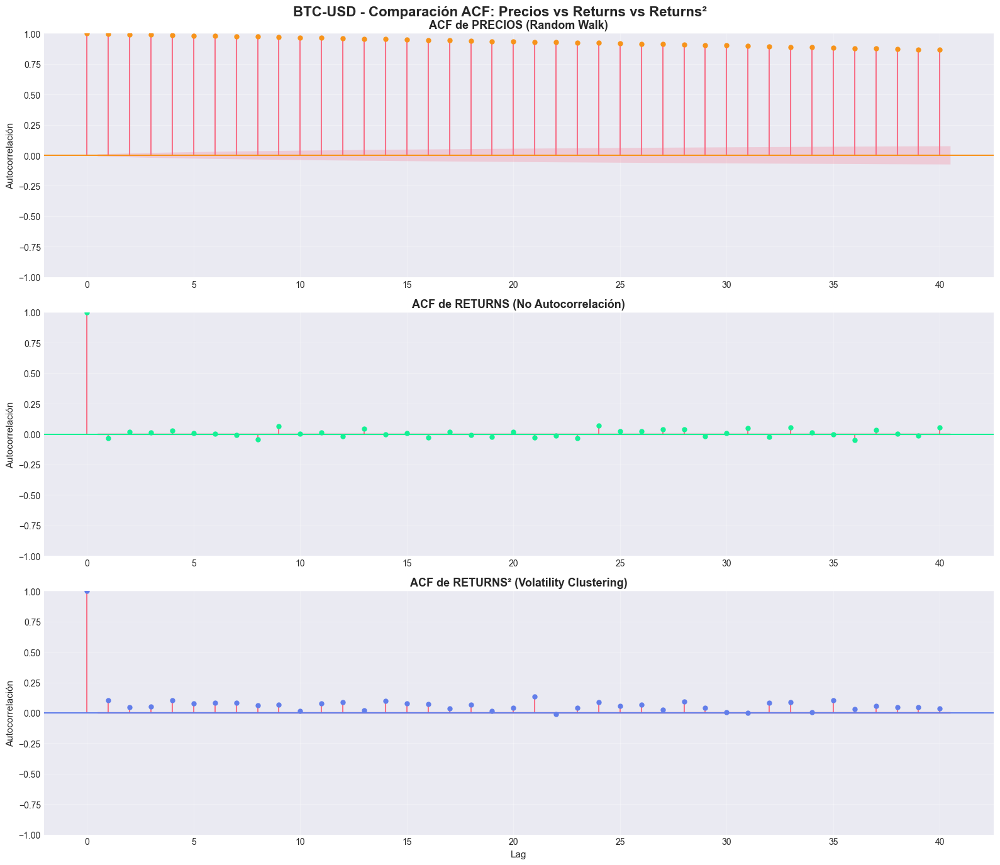

In [37]:
from statsmodels.graphics.tsaplots import plot_acf

print("\n" + "="*80)
print("📊 COMPARACIÓN VISUAL: ACF de Precios, Returns y Returns²")
print("="*80)

# Seleccionar BTC como ejemplo representativo
crypto_example = 'BTC-USD'
example_prices = crypto_data[crypto_example]['Close']
example_returns = crypto_returns[crypto_example]['Simple_Return'].dropna()
example_returns2 = example_returns ** 2

fig, axes = plt.subplots(3, 1, figsize=(16, 14))
fig.suptitle(f'{crypto_example} - Comparación ACF: Precios vs Returns vs Returns²', 
             fontsize=16, fontweight='bold')

# ACF Precios
plot_acf(example_prices, lags=40, ax=axes[0], color='#F7931A', alpha=0.7)
axes[0].set_title('ACF de PRECIOS (Random Walk)', fontsize=13, fontweight='bold')
axes[0].set_ylabel('Autocorrelación', fontsize=11)
axes[0].grid(True, alpha=0.3)

# ACF Returns
plot_acf(example_returns, lags=40, ax=axes[1], color='#14F195', alpha=0.7)
axes[1].set_title('ACF de RETURNS (No Autocorrelación)', fontsize=13, fontweight='bold')
axes[1].set_ylabel('Autocorrelación', fontsize=11)
axes[1].grid(True, alpha=0.3)

# ACF Returns²
plot_acf(example_returns2, lags=40, ax=axes[2], color='#627EEA', alpha=0.7)
axes[2].set_title('ACF de RETURNS² (Volatility Clustering)', fontsize=13, fontweight='bold')
axes[2].set_xlabel('Lag', fontsize=11)
axes[2].set_ylabel('Autocorrelación', fontsize=11)
axes[2].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

In [38]:
print("\n" + "="*80)
print("📊 TABLA RESUMEN - VOLATILITY CLUSTERING")
print("="*80)

acf_summary_df = pd.DataFrame(acf_returns2_summary)
print("\n", acf_summary_df.to_string(index=False))


📊 TABLA RESUMEN - VOLATILITY CLUSTERING

   Crypto    ACF_1     ACF_5   ACF_10  Avg_ACF  Significant_Lags
 ETH-USD 0.123138  0.180486 0.054259 0.094516                 9
 XRP-USD 0.084718  0.067088 0.002511 0.037292                 3
DOGE-USD 0.013646 -0.000051 0.009527 0.006313                 0
 ADA-USD 0.123407  0.044201 0.022004 0.040270                 1
 BTC-USD 0.102083  0.076858 0.015854 0.068783                 8


In [39]:
print("\n" + "="*80)
print("💡 RESUMEN DE HALLAZGOS - ANÁLISIS ACF")
print("="*80)

print("""
✅ CONFIRMACIÓN DE HIPÓTESIS:

1. PRECIOS:
   ✓ ACF muy alto (~0.99) y decae lentamente
   ✓ Confirma que son RANDOM WALKS
   ✓ Consistente con Test ADF
   
2. RETURNS:
   ✓ ACF ≈ 0 para todos los lags
   ✓ NO hay autocorrelación significativa
   ✓ Returns son IMPREDECIBLES
   ✓ Confirma Efficient Market Hypothesis
   
3. RETURNS² (Volatilidad):
   ✓ ACF significativamente > 0
   ✓ VOLATILITY CLUSTERING presente
   ✓ Alta volatilidad persiste en el tiempo
   ✓ Justifica modelos GARCH

📊 IMPLICACIONES PRÁCTICAS:

❌ NO PUEDES PREDECIR:
   • Dirección del precio (subir/bajar)
   • Magnitud exacta del return
   • Timing de compra/venta basado solo en historia

✅ SÍ PUEDES PREDECIR/MODELAR:
   • Volatilidad futura (usando returns²)
   • Períodos de alto riesgo
   • Rangos de variación esperados
   • Value at Risk (VaR)

💼 ESTRATEGIAS VIABLES:
   • Gestión de riesgo dinámica (ajustar posiciones por volatilidad)
   • Diversificación temporal (rebalanceo)
   • Hedging en períodos de alta volatilidad
   • Opciones y derivados (modelar volatilidad)

🚫 ESTRATEGIAS NO VIABLES:
   • Market timing basado solo en precios pasados
   • Análisis técnico puro (sin fundamentos)
   • Day trading sin gestión de riesgo

📚 CONCLUSIÓN ACADÉMICA:
   "Los mercados de criptomonedas son informationally efficient 
   (precios random walk) pero volatility inefficient (clustering),
   lo cual es consistente con la literatura moderna de finanzas."
""")

print("\n" + "="*80)
print("🎯 RESPUESTA FINAL A LAS PREGUNTAS DE NEGOCIO")
print("="*80)

print("""
❓ ¿Son las cryptos inversiones predecibles o aleatorias?

RESPUESTA COMPLETA:

1. PRECIOS: ALEATORIOS (Random Walk)
   → No puedes predecir el precio futuro solo con historia
   → Consistente con mercados eficientes
   
2. RETURNS: ALEATORIOS (No autocorrelación)
   → No puedes predecir si subirá o bajará mañana
   → El mejor predictor de mañana es "no cambio"
   
3. VOLATILIDAD: PREDECIBLE (Clustering)
   → SÍ puedes predecir cuánto variará (no dirección)
   → Alta volatilidad hoy → Alta volatilidad mañana
   
💡 METÁFORA:
   Es como el clima:
   • No puedes predecir la temperatura exacta de mañana
   • Pero SÍ puedes predecir si será un día "volátil" o "estable"

🎯 PARA EL INVERSIONISTA RETAIL:
   • Enfócate en: Horizonte largo plazo, diversificación, gestión de riesgo
   • Evita: Intentar "timing the market" con análisis técnico puro
   • Considera: Dollar-cost averaging, rebalanceo, stop-losses dinámicos
""")



💡 RESUMEN DE HALLAZGOS - ANÁLISIS ACF

✅ CONFIRMACIÓN DE HIPÓTESIS:

1. PRECIOS:
   ✓ ACF muy alto (~0.99) y decae lentamente
   ✓ Confirma que son RANDOM WALKS
   ✓ Consistente con Test ADF
   
2. RETURNS:
   ✓ ACF ≈ 0 para todos los lags
   ✓ NO hay autocorrelación significativa
   ✓ Returns son IMPREDECIBLES
   ✓ Confirma Efficient Market Hypothesis
   
3. RETURNS² (Volatilidad):
   ✓ ACF significativamente > 0
   ✓ VOLATILITY CLUSTERING presente
   ✓ Alta volatilidad persiste en el tiempo
   ✓ Justifica modelos GARCH

📊 IMPLICACIONES PRÁCTICAS:

❌ NO PUEDES PREDECIR:
   • Dirección del precio (subir/bajar)
   • Magnitud exacta del return
   • Timing de compra/venta basado solo en historia

✅ SÍ PUEDES PREDECIR/MODELAR:
   • Volatilidad futura (usando returns²)
   • Períodos de alto riesgo
   • Rangos de variación esperados
   • Value at Risk (VaR)

💼 ESTRATEGIAS VIABLES:
   • Gestión de riesgo dinámica (ajustar posiciones por volatilidad)
   • Diversificación temporal (rebalanceo)

In [40]:
print("="*80)
print(" ANÁLISIS DE VOLATILIDAD Y CLUSTERING")
print("="*80)

print("""
🎯 OBJETIVO FINAL: Analizar la volatilidad en el tiempo y detectar clustering

📚 CONCEPTOS CLAVE:

1. VOLATILIDAD:
   • Medida de variabilidad de returns
   • Alta volatilidad = Alto riesgo
   • Se calcula típicamente como desviación estándar de returns
   
2. ROLLING VOLATILITY:
   • Volatilidad calculada en ventanas móviles (ej: 30 días)
   • Permite ver cómo cambia el riesgo en el tiempo
   • Útil para ajustar estrategias dinámicamente
   
3. VOLATILITY CLUSTERING:
   • "Períodos volátiles tienden a seguir períodos volátiles"
   • "Períodos tranquilos tienden a seguir períodos tranquilos"
   • Observado por Benoit Mandelbrot (1963)
   
4. IMPLICACIONES:
   • Gestión de riesgo dinámica
   • Ajuste de posiciones según volatilidad
   • Pricing de opciones y derivados
   • Value at Risk (VaR) condicional
""")

colors = ['#F7931A', '#627EEA', '#14F195', '#C2A633', '#26A17B']

 ANÁLISIS DE VOLATILIDAD Y CLUSTERING

🎯 OBJETIVO FINAL: Analizar la volatilidad en el tiempo y detectar clustering

📚 CONCEPTOS CLAVE:

1. VOLATILIDAD:
   • Medida de variabilidad de returns
   • Alta volatilidad = Alto riesgo
   • Se calcula típicamente como desviación estándar de returns
   
2. ROLLING VOLATILITY:
   • Volatilidad calculada en ventanas móviles (ej: 30 días)
   • Permite ver cómo cambia el riesgo en el tiempo
   • Útil para ajustar estrategias dinámicamente
   
3. VOLATILITY CLUSTERING:
   • "Períodos volátiles tienden a seguir períodos volátiles"
   • "Períodos tranquilos tienden a seguir períodos tranquilos"
   • Observado por Benoit Mandelbrot (1963)
   
4. IMPLICACIONES:
   • Gestión de riesgo dinámica
   • Ajuste de posiciones según volatilidad
   • Pricing de opciones y derivados
   • Value at Risk (VaR) condicional



In [41]:
print("\n" + "="*80)
print("📊 CALCULANDO ROLLING VOLATILITY")
print("="*80)

# Parámetros
window_sizes = [7, 30, 90]  # 1 semana, 1 mes, 3 meses

# Diccionario para guardar volatilidades
rolling_volatility = {}

for crypto, returns_df in crypto_returns.items():
    returns = returns_df['Simple_Return']
    
    vol_data = {
        'Date': returns_df['Date'],
        'Returns': returns
    }
    
    # Calcular volatilidad para cada ventana
    for window in window_sizes:
        vol_data[f'Vol_{window}d'] = returns.rolling(window=window).std()
    
    rolling_volatility[crypto] = pd.DataFrame(vol_data)
    
    print(f"✅ {crypto}: Rolling volatility calculada para ventanas de {window_sizes}")


📊 CALCULANDO ROLLING VOLATILITY
✅ ETH-USD: Rolling volatility calculada para ventanas de [7, 30, 90]
✅ XRP-USD: Rolling volatility calculada para ventanas de [7, 30, 90]
✅ DOGE-USD: Rolling volatility calculada para ventanas de [7, 30, 90]
✅ ADA-USD: Rolling volatility calculada para ventanas de [7, 30, 90]
✅ BTC-USD: Rolling volatility calculada para ventanas de [7, 30, 90]



📈 VISUALIZACIÓN: PRECIOS Y VOLATILIDAD EN EL TIEMPO


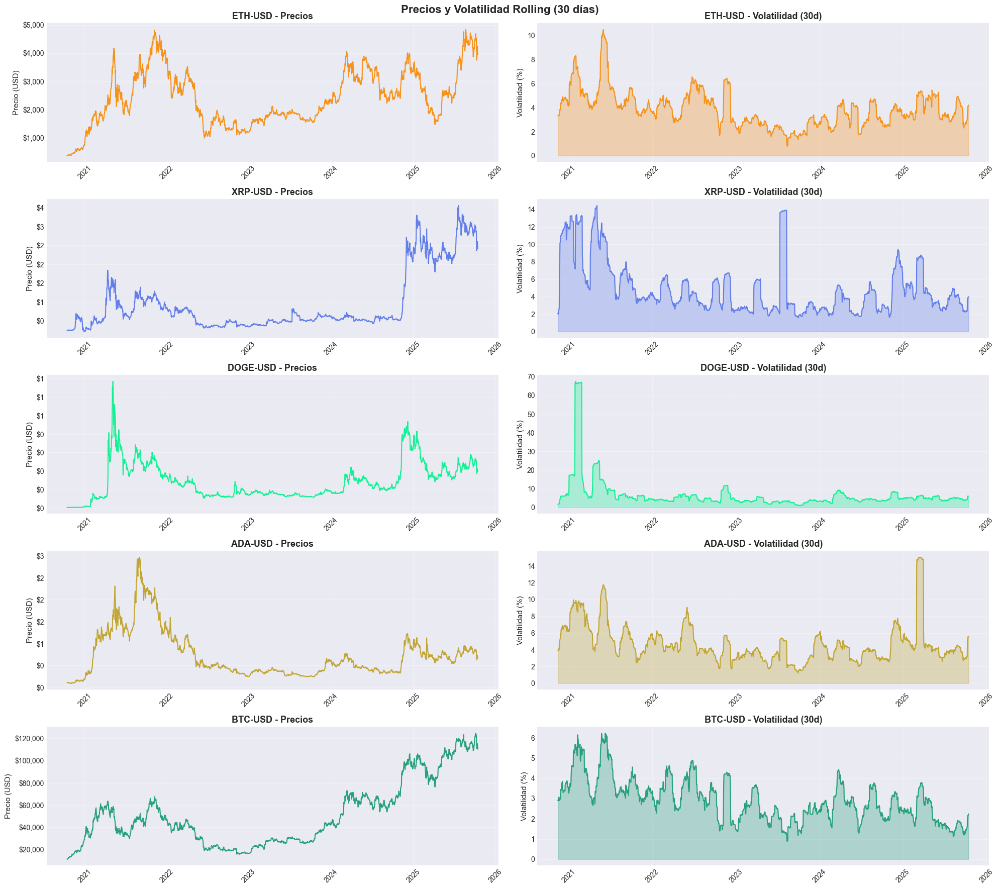

In [42]:
print("\n" + "="*80)
print("📈 VISUALIZACIÓN: PRECIOS Y VOLATILIDAD EN EL TIEMPO")
print("="*80)

# Figura 1: Precios + Rolling Volatility (30 días)
fig, axes = plt.subplots(5, 2, figsize=(20, 18))
fig.suptitle('Precios y Volatilidad Rolling (30 días)', fontsize=16, fontweight='bold')

for idx, (crypto, data) in enumerate(crypto_data.items()):
    # Subplot para PRECIOS
    ax1 = axes[idx, 0]
    ax1.plot(data['Date'], data['Close'], color=colors[idx], linewidth=1.5)
    ax1.set_title(f'{crypto} - Precios', fontsize=13, fontweight='bold')
    ax1.set_ylabel('Precio (USD)', fontsize=11)
    ax1.grid(True, alpha=0.3)
    ax1.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'${x:,.0f}'))
    plt.setp(ax1.xaxis.get_majorticklabels(), rotation=45)
    
    # Subplot para VOLATILIDAD
    ax2 = axes[idx, 1]
    vol_data = rolling_volatility[crypto]
    ax2.plot(vol_data['Date'], vol_data['Vol_30d'], color=colors[idx], linewidth=1.5)
    ax2.fill_between(vol_data['Date'], vol_data['Vol_30d'], alpha=0.3, color=colors[idx])
    ax2.set_title(f'{crypto} - Volatilidad (30d)', fontsize=13, fontweight='bold')
    ax2.set_ylabel('Volatilidad (%)', fontsize=11)
    ax2.grid(True, alpha=0.3)
    plt.setp(ax2.xaxis.get_majorticklabels(), rotation=45)

plt.tight_layout()
plt.show()


📊 COMPARACIÓN: DIFERENTES VENTANAS DE TIEMPO


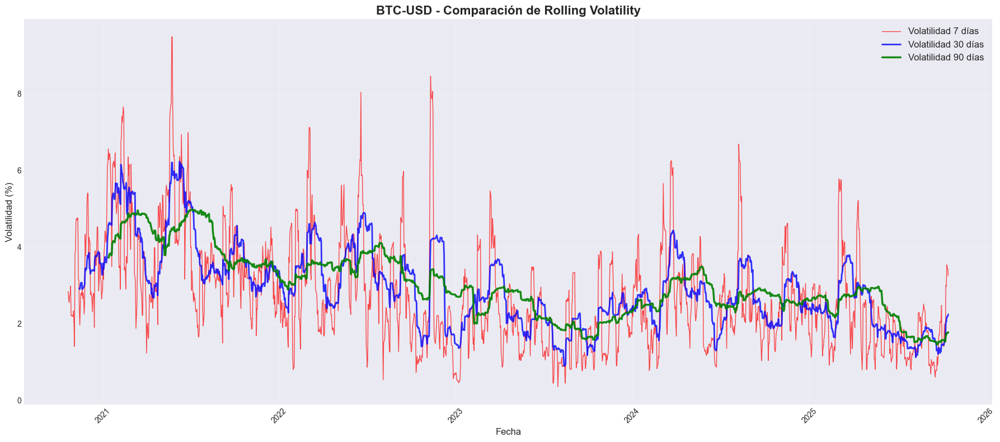


💡 OBSERVACIÓN:
   • Ventana corta (7d): Más reactiva, captura cambios rápidos
   • Ventana media (30d): Balance entre reactividad y suavizado
   • Ventana larga (90d): Más suave, muestra tendencias de largo plazo


In [43]:
print("\n" + "="*80)
print("📊 COMPARACIÓN: DIFERENTES VENTANAS DE TIEMPO")
print("="*80)

# Seleccionar BTC como ejemplo
crypto_example = 'BTC-USD'
vol_example = rolling_volatility[crypto_example]

fig, ax = plt.subplots(figsize=(18, 8))

ax.plot(vol_example['Date'], vol_example['Vol_7d'], 
        label='Volatilidad 7 días', linewidth=1, alpha=0.7, color='red')
ax.plot(vol_example['Date'], vol_example['Vol_30d'], 
        label='Volatilidad 30 días', linewidth=2, alpha=0.8, color='blue')
ax.plot(vol_example['Date'], vol_example['Vol_90d'], 
        label='Volatilidad 90 días', linewidth=2.5, alpha=0.9, color='green')

ax.set_title(f'{crypto_example} - Comparación de Rolling Volatility', 
             fontsize=16, fontweight='bold')
ax.set_xlabel('Fecha', fontsize=12)
ax.set_ylabel('Volatilidad (%)', fontsize=12)
ax.legend(loc='best', fontsize=12)
ax.grid(True, alpha=0.3)
plt.setp(ax.xaxis.get_majorticklabels(), rotation=45)
plt.tight_layout()
plt.show()

print("\n💡 OBSERVACIÓN:")
print("   • Ventana corta (7d): Más reactiva, captura cambios rápidos")
print("   • Ventana media (30d): Balance entre reactividad y suavizado")
print("   • Ventana larga (90d): Más suave, muestra tendencias de largo plazo")

In [44]:
print("\n" + "="*80)
print("🔥 IDENTIFICACIÓN DE PERÍODOS DE ALTA VOLATILIDAD")
print("="*80)

# Definir umbrales (percentil 90 como "alta volatilidad")
high_vol_events = []

for crypto, vol_data in rolling_volatility.items():
    vol_30d = vol_data['Vol_30d'].dropna()
    
    # Calcular umbral (percentil 90)
    threshold = vol_30d.quantile(0.90)
    
    # Identificar períodos por encima del umbral
    high_vol_periods = vol_data[vol_data['Vol_30d'] > threshold]
    
    if len(high_vol_periods) > 0:
        print(f"\n{crypto}:")
        print(f"   Umbral 90%: {threshold:.2f}%")
        print(f"   Períodos de alta volatilidad: {len(high_vol_periods)} días")
        print(f"   Volatilidad máxima: {vol_30d.max():.2f}%")
        print(f"   Volatilidad promedio: {vol_30d.mean():.2f}%")



🔥 IDENTIFICACIÓN DE PERÍODOS DE ALTA VOLATILIDAD

ETH-USD:
   Umbral 90%: 5.61%
   Períodos de alta volatilidad: 180 días
   Volatilidad máxima: 10.49%
   Volatilidad promedio: 3.88%

XRP-USD:
   Umbral 90%: 10.25%
   Períodos de alta volatilidad: 180 días
   Volatilidad máxima: 14.45%
   Volatilidad promedio: 4.93%

DOGE-USD:
   Umbral 90%: 9.18%
   Períodos de alta volatilidad: 180 días
   Volatilidad máxima: 67.54%
   Volatilidad promedio: 6.54%

ADA-USD:
   Umbral 90%: 7.31%
   Períodos de alta volatilidad: 180 días
   Volatilidad máxima: 15.03%
   Volatilidad promedio: 4.73%

BTC-USD:
   Umbral 90%: 4.34%
   Períodos de alta volatilidad: 180 días
   Volatilidad máxima: 6.23%
   Volatilidad promedio: 2.92%



🎨 VISUALIZACIÓN DE VOLATILITY CLUSTERING


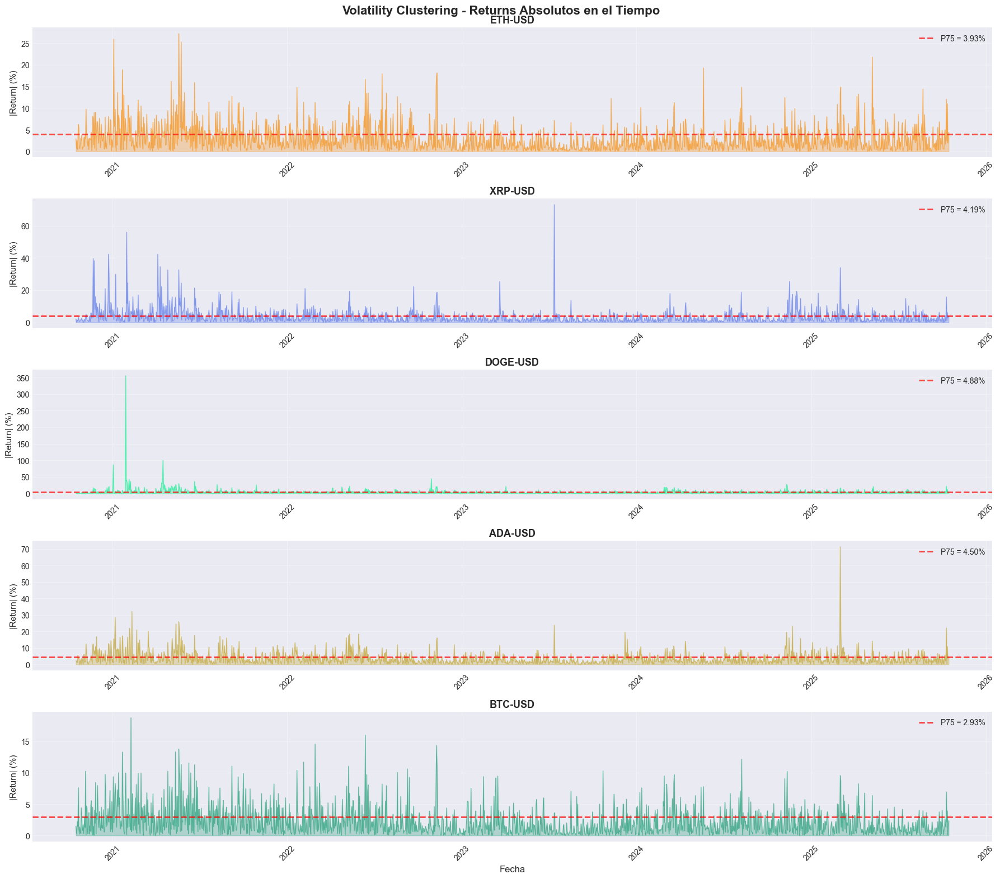


💡 INTERPRETACIÓN:
   ✅ Clustering visible: Períodos de alta volatilidad se agrupan
   ✅ No hay distribución uniforme en el tiempo
   ✅ Confirma hallazgos del ACF de returns²


In [45]:
print("\n" + "="*80)
print("🎨 VISUALIZACIÓN DE VOLATILITY CLUSTERING")
print("="*80)

# Figura 2: Returns absolutos (proxy de volatilidad instantánea)
fig, axes = plt.subplots(5, 1, figsize=(18, 16))
fig.suptitle('Volatility Clustering - Returns Absolutos en el Tiempo', 
             fontsize=16, fontweight='bold')

for idx, (crypto, returns_df) in enumerate(crypto_returns.items()):
    ax = axes[idx]
    
    returns_abs = returns_df['Simple_Return'].abs()
    
    # Plot de returns absolutos
    ax.plot(returns_df['Date'], returns_abs, color=colors[idx], 
            linewidth=0.8, alpha=0.6)
    ax.fill_between(returns_df['Date'], returns_abs, alpha=0.3, color=colors[idx])
    
    # Línea de umbral (percentil 75)
    threshold = returns_abs.quantile(0.75)
    ax.axhline(y=threshold, color='red', linestyle='--', linewidth=2, 
               alpha=0.7, label=f'P75 = {threshold:.2f}%')
    
    ax.set_title(f'{crypto}', fontsize=13, fontweight='bold')
    ax.set_ylabel('|Return| (%)', fontsize=11)
    ax.legend(loc='best')
    ax.grid(True, alpha=0.3)
    
    if idx == 4:
        ax.set_xlabel('Fecha', fontsize=12)
    
    plt.setp(ax.xaxis.get_majorticklabels(), rotation=45)

plt.tight_layout()
plt.show()

print("\n💡 INTERPRETACIÓN:")
print("   ✅ Clustering visible: Períodos de alta volatilidad se agrupan")
print("   ✅ No hay distribución uniforme en el tiempo")
print("   ✅ Confirma hallazgos del ACF de returns²")



📊 ESTADÍSTICAS COMPARATIVAS DE VOLATILIDAD

📈 Volatilidad Rolling 30 días - Estadísticas:
  Crypto  Vol_Media  Vol_Mediana  Vol_Min   Vol_Max  Vol_Std   Coef_Var
DOGE-USD   6.543339     4.651434 1.051731 67.538135 8.630207 131.893019
 XRP-USD   4.927147     3.874155 1.583341 14.451864 3.040542  61.709999
 ADA-USD   4.728191     4.159372 1.223501 15.033164 2.301383  48.673639
 ETH-USD   3.875495     3.670327 0.805873 10.490903 1.496431  38.612630
 BTC-USD   2.922324     2.789395 0.888669  6.230881 1.058388  36.217329


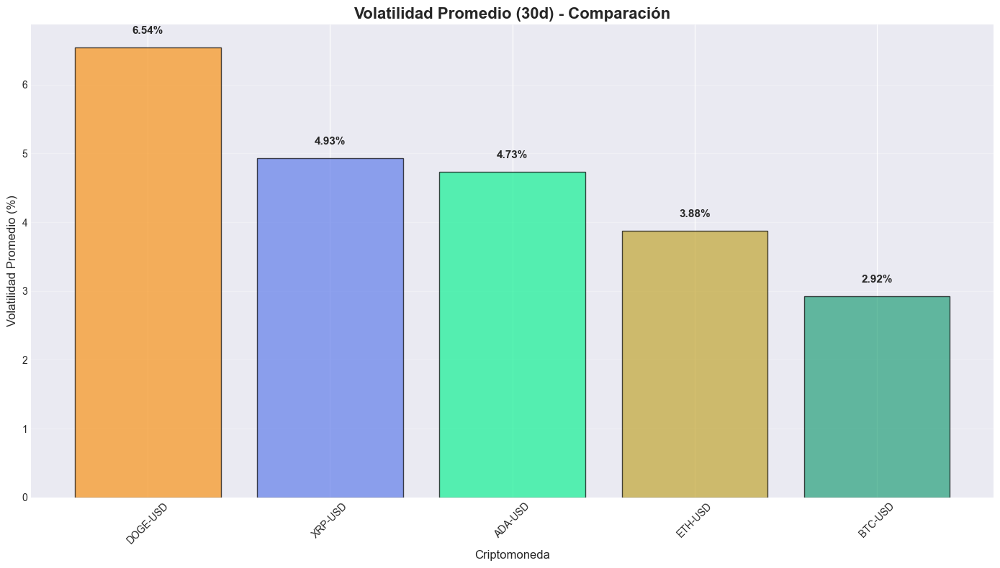

In [46]:
print("\n" + "="*80)
print("📊 ESTADÍSTICAS COMPARATIVAS DE VOLATILIDAD")
print("="*80)

vol_stats = []

for crypto, vol_data in rolling_volatility.items():
    vol_30d = vol_data['Vol_30d'].dropna()
    
    stats = {
        'Crypto': crypto,
        'Vol_Media': vol_30d.mean(),
        'Vol_Mediana': vol_30d.median(),
        'Vol_Min': vol_30d.min(),
        'Vol_Max': vol_30d.max(),
        'Vol_Std': vol_30d.std(),
        'Coef_Var': (vol_30d.std() / vol_30d.mean()) * 100
    }
    
    vol_stats.append(stats)

vol_stats_df = pd.DataFrame(vol_stats)
vol_stats_df = vol_stats_df.sort_values('Vol_Media', ascending=False)

print("\n📈 Volatilidad Rolling 30 días - Estadísticas:")
print(vol_stats_df.to_string(index=False))

# Visualización comparativa
fig, ax = plt.subplots(figsize=(14, 8))

cryptos = vol_stats_df['Crypto'].values
vol_means = vol_stats_df['Vol_Media'].values

bars = ax.bar(cryptos, vol_means, color=colors, alpha=0.7, edgecolor='black')

# Agregar valores en las barras
for i, (crypto, vol) in enumerate(zip(cryptos, vol_means)):
    ax.text(i, vol + 0.2, f'{vol:.2f}%', ha='center', fontsize=11, fontweight='bold')

ax.set_title('Volatilidad Promedio (30d) - Comparación', fontsize=16, fontweight='bold')
ax.set_ylabel('Volatilidad Promedio (%)', fontsize=12)
ax.set_xlabel('Criptomoneda', fontsize=12)
ax.grid(True, alpha=0.3, axis='y')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



🔗 CORRELACIÓN ENTRE VOLATILIDADES

📊 Matriz de Correlación de Volatilidades:
          ETH-USD  XRP-USD  DOGE-USD  ADA-USD  BTC-USD
ETH-USD     1.000    0.529     0.465    0.677    0.821
XRP-USD     0.529    1.000     0.542    0.652    0.522
DOGE-USD    0.465    0.542     1.000    0.433    0.502
ADA-USD     0.677    0.652     0.433    1.000    0.645
BTC-USD     0.821    0.522     0.502    0.645    1.000


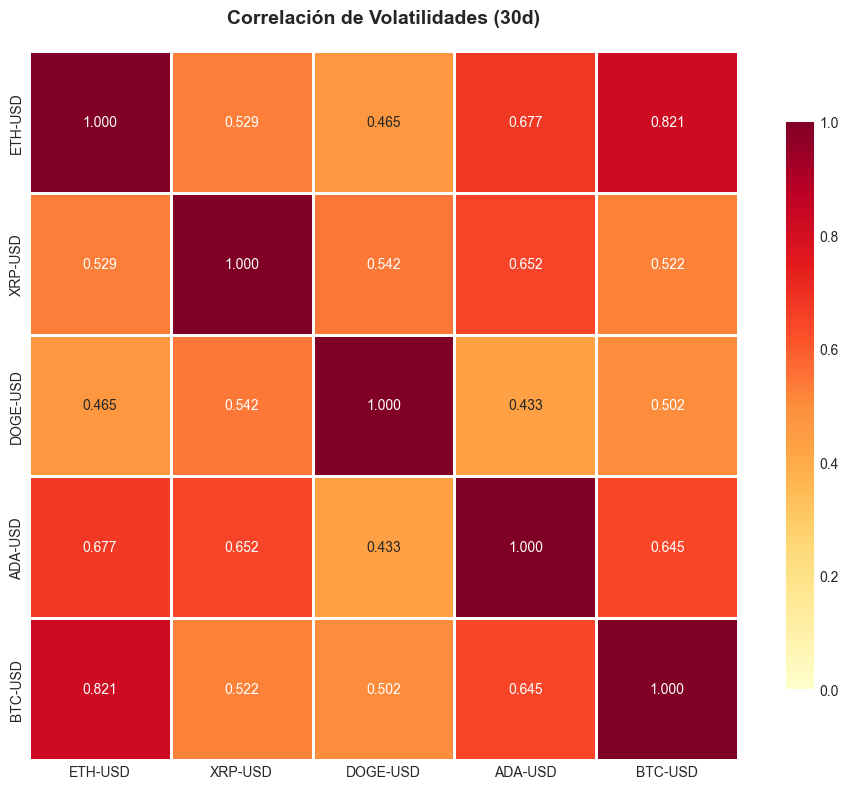


💡 INTERPRETACIÓN:
   • Alta correlación de volatilidades → Shocks afectan todo el mercado
   • Períodos de alta volatilidad son sistémicos
   • Dificulta diversificación en períodos de crisis


In [47]:
print("\n" + "="*80)
print("🔗 CORRELACIÓN ENTRE VOLATILIDADES")
print("="*80)

# Crear DataFrame con volatilidades alineadas
vol_corr_df = pd.DataFrame()

for crypto, vol_data in rolling_volatility.items():
    temp = vol_data[['Date', 'Vol_30d']].copy()
    temp.columns = ['Date', crypto]
    
    if vol_corr_df.empty:
        vol_corr_df = temp
    else:
        vol_corr_df = pd.merge(vol_corr_df, temp, on='Date', how='outer')

# Calcular correlación
vol_corr_clean = vol_corr_df.drop('Date', axis=1).dropna()
vol_correlation = vol_corr_clean.corr()

print("\n📊 Matriz de Correlación de Volatilidades:")
print(vol_correlation.round(3))

# Visualizar
plt.figure(figsize=(10, 8))
sns.heatmap(vol_correlation, annot=True, cmap='YlOrRd', center=0.5, 
            square=True, linewidths=1, cbar_kws={"shrink": 0.8},
            fmt='.3f', vmin=0, vmax=1)
plt.title('Correlación de Volatilidades (30d)', fontsize=14, fontweight='bold', pad=20)
plt.tight_layout()
plt.show()

print("\n💡 INTERPRETACIÓN:")
print("   • Alta correlación de volatilidades → Shocks afectan todo el mercado")
print("   • Períodos de alta volatilidad son sistémicos")
print("   • Dificulta diversificación en períodos de crisis")

In [48]:
print("\n" + "="*80)
print("🔔 DETECCIÓN DE EVENTOS DE ALTA VOLATILIDAD")
print("="*80)

# Detectar días con volatilidad extrema (> percentil 95)
for crypto, returns_df in crypto_returns.items():
    returns_abs = returns_df['Simple_Return'].abs()
    threshold = returns_abs.quantile(0.95)
    
    extreme_days = returns_df[returns_abs > threshold].sort_values('Simple_Return', key=abs, ascending=False)
    
    if len(extreme_days) > 0:
        print(f"\n{crypto} - Top 5 días más volátiles:")
        print(extreme_days[['Date', 'Simple_Return']].head(5).to_string(index=False))


🔔 DETECCIÓN DE EVENTOS DE ALTA VOLATILIDAD

ETH-USD - Top 5 días más volátiles:
      Date  Simple_Return
2021-05-19     -27.200349
2021-01-03      25.947533
2021-05-24      25.313630
2025-05-08      21.798769
2024-05-20      19.272223

XRP-USD - Top 5 días más volátiles:
      Date  Simple_Return
2023-07-13      73.075005
2021-01-30      56.010883
2020-12-23     -42.334007
2021-04-05      42.327465
2020-11-21      39.710069

DOGE-USD - Top 5 días más volátiles:
      Date  Simple_Return
2021-01-28     355.546631
2021-04-16     100.799087
2021-01-02      86.719422
2021-04-15      49.943629
2022-10-29      44.943197

ADA-USD - Top 5 días más volátiles:
      Date  Simple_Return
2025-03-02      71.327621
2021-02-10      32.238356
2021-01-06      28.486256
2021-05-19     -26.009428
2021-05-13      24.529825

BTC-USD - Top 5 días más volátiles:
      Date  Simple_Return
2021-02-08      18.746474
2022-06-13     -15.974726
2022-02-28      14.541184
2022-11-09     -14.349022
2021-05-19     -

In [49]:
print("\n" + "="*80)
print("🎯 RESUMEN FINAL - ANÁLISIS COMPLETO DE TIME SERIES")
print("="*80)

print("""
✅ HALLAZGOS PRINCIPALES:

1. PRECIOS (Paso 1 & 3):
   ✓ Son RANDOM WALKS → No predecibles
   ✓ Confirma Hipótesis de Mercado Eficiente
   ✓ BTC, ETH, SOL son claramente random walks
   
2. RETURNS (Paso 2 & 4):
   ✓ Distribución NO normal (fat tails)
   ✓ ACF ≈ 0 → No autocorrelación
   ✓ No se puede predecir dirección futura
   
3. VOLATILIDAD (Paso 4 & 5):
   ✓ VOLATILITY CLUSTERING presente
   ✓ ACF de returns² > 0 → Volatilidad predecible
   ✓ Rolling volatility muestra períodos claros
   
4. CORRELACIONES:
   ✓ Returns correlacionados (0.3-0.8)
   ✓ Volatilidades altamente correlacionadas (>0.6)
   ✓ Shocks sistémicos afectan todo el mercado

📊 RANKING DE RIESGO (Volatilidad 30d):
""")

# Mostrar ranking
for idx, row in vol_stats_df.iterrows():
    print(f"   {idx+1}. {row['Crypto']}: {row['Vol_Media']:.2f}% promedio")

print("""

💼 RECOMENDACIONES PARA INVERSIONISTAS:

❌ ESTRATEGIAS NO RECOMENDADAS:
   • Market timing basado solo en precios históricos
   • Day trading sin gestión de riesgo
   • Análisis técnico puro (sin fundamentos)
   • Ignorar períodos de alta volatilidad

✅ ESTRATEGIAS RECOMENDADAS:
   • Horizonte de inversión LARGO PLAZO (>1 año)
   • Dollar-cost averaging (compras periódicas)
   • Diversificación (aunque limitada dentro de crypto)
   • Gestión de riesgo DINÁMICA basada en volatilidad:
     → Reducir exposición cuando volatilidad > P75
     → Aumentar exposición cuando volatilidad < P25
   • Stop-losses ajustados por volatilidad
   • Rebalanceo periódico de portfolio
   • Considerar análisis fundamental + on-chain

📈 GESTIÓN DE RIESGO PRÁCTICA:

1. MONITOREO DE VOLATILIDAD:
   • Calcular rolling volatility 30d semanalmente
   • Umbral de alerta: > percentil 75
   • Umbral de crisis: > percentil 90

2. AJUSTE DE POSICIONES:
   • Volatilidad baja → Posición normal
   • Volatilidad alta → Reducir 30-50%
   • Volatilidad extrema → Liquidez defensiva

3. DIVERSIFICACIÓN TEMPORAL:
   • No invertir todo de una vez
   • Distribuir compras en 6-12 meses
   • Aprovechar caídas en períodos tranquilos

🎓 CONCLUSIÓN ACADÉMICA:

"Los mercados de criptomonedas exhiben características consistentes con la 
teoría moderna de finanzas: precios como random walks (eficiencia informacional) 
pero con volatility clustering (ineficiencia de segundo momento). Esto sugiere 
que mientras la DIRECCIÓN del precio no es predecible, el RIESGO futuro sí 
puede estimarse, validando estrategias de gestión de riesgo dinámica sobre 
estrategias de market timing."

📚 MODELOS AVANZADOS SUGERIDOS (Post-análisis):
   • GARCH(1,1): Modelar volatilidad condicional
   • EGARCH: Capturar asimetrías (leverage effect)
   • Copulas: Modelar dependencia conjunta en extremos
   • Jump-Diffusion: Modelar eventos extremos
   • Regime-Switching: Detectar cambios de régimen
""")


🎯 RESUMEN FINAL - ANÁLISIS COMPLETO DE TIME SERIES

✅ HALLAZGOS PRINCIPALES:

1. PRECIOS (Paso 1 & 3):
   ✓ Son RANDOM WALKS → No predecibles
   ✓ Confirma Hipótesis de Mercado Eficiente
   ✓ BTC, ETH, SOL son claramente random walks
   
2. RETURNS (Paso 2 & 4):
   ✓ Distribución NO normal (fat tails)
   ✓ ACF ≈ 0 → No autocorrelación
   ✓ No se puede predecir dirección futura
   
3. VOLATILIDAD (Paso 4 & 5):
   ✓ VOLATILITY CLUSTERING presente
   ✓ ACF de returns² > 0 → Volatilidad predecible
   ✓ Rolling volatility muestra períodos claros
   
4. CORRELACIONES:
   ✓ Returns correlacionados (0.3-0.8)
   ✓ Volatilidades altamente correlacionadas (>0.6)
   ✓ Shocks sistémicos afectan todo el mercado

📊 RANKING DE RIESGO (Volatilidad 30d):

   3. DOGE-USD: 6.54% promedio
   2. XRP-USD: 4.93% promedio
   4. ADA-USD: 4.73% promedio
   1. ETH-USD: 3.88% promedio
   5. BTC-USD: 2.92% promedio


💼 RECOMENDACIONES PARA INVERSIONISTAS:

❌ ESTRATEGIAS NO RECOMENDADAS:
   • Market timing basado s

# Spatial analysis

In [50]:
import pandas as pd
import geopandas as gpd
import matplotlib as plt

## 1. Loading data

In [51]:
#loading geographical data
spatial_df = gpd.read_file("https://naturalearth.s3.amazonaws.com/110m_cultural/ne_110m_admin_0_countries.zip")
spatial_df

,featurecla,scalerank,LABELRANK,SOVEREIGNT,SOV_A3,ADM0_DIF,LEVEL,TYPE,TLC,ADMIN,...,FCLASS_TR,FCLASS_ID,FCLASS_PL,FCLASS_GR,FCLASS_IT,FCLASS_NL,FCLASS_SE,FCLASS_BD,FCLASS_UA,geometry
0,Admin-0 country,1,6,Fiji,FJI,0,2,Sovereign country,1,Fiji,...,None,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((180 -16.06713, 180 -16.55522, ..."
1,Admin-0 country,1,3,United Republic of Tanzania,TZA,0,2,Sovereign country,1,United Republic of Tanzania,...,None,None,None,None,None,None,None,None,None,"POLYGON ((33.90371 -0.95, 34.07262 -1.05982, 3..."
2,Admin-0 country,1,7,Western Sahara,SAH,0,2,Indeterminate,1,Western Sahara,...,Unrecognized,Unrecognized,Unrecognized,None,None,Unrecognized,None,None,None,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,Admin-0 country,1,2,Canada,CAN,0,2,Sovereign country,1,Canada,...,None,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((-122.84 49, -122.97421 49.0025..."
4,Admin-0 country,1,2,United States of America,US1,1,2,Country,1,United States of America,...,None,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((-122.84 49, -120 49, -117.0312..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
172,Admin-0 country,1,5,Republic of Serbia,SRB,0,2,Sovereign country,1,Republic of Serbia,...,None,None,None,None,None,None,None,None,None,"POLYGON ((18.82982 45.90887, 18.82984 45.90888..."
173,Admin-0 country,1,6,Montenegro,MNE,0,2,Sovereign country,1,Montenegro,...,None,None,None,None,None,None,None,None,None,"POLYGON ((20.0707 42.58863, 19.80161 42.50009,..."
174,Admin-0 country,1,6,Kosovo,KOS,0,2,Disputed,1,Kosovo,...,Admin-0 country,Unrecognized,Admin-0 country,Unrecognized,Admin-0 country,Admin-0 country,Admin-0 country,Admin-0 country,Unrecognized,"POLYGON ((20.59025 41.85541, 20.52295 42.21787..."
175,Admin-0 country,1,5,Trinidad and Tobago,TTO,0,2,Sovereign country,1,Trinidad and Tobago,...,None,None,None,None,None,None,None,None,None,"POLYGON ((-61.68 10.76, -61.105 10.89, -60.895..."


In [52]:
#loading trending data
trends_df = pd.read_csv("./data/trends_fixed.csv")
trends_df

,date,country,keyword,interest
0,2020-10-11,BR,Bitcoin,9
1,2020-10-18,BR,Bitcoin,13
2,2020-10-25,BR,Bitcoin,13
3,2020-11-01,BR,Bitcoin,16
4,2020-11-08,BR,Bitcoin,15
...,...,...,...,...
15655,2025-09-07,US,Cryptocurrency,8
15656,2025-09-14,US,Cryptocurrency,10
15657,2025-09-21,US,Cryptocurrency,11
15658,2025-09-28,US,Cryptocurrency,9


In [53]:
temporal_df = pd.read_csv('././data/sample_temporal.csv', header=None)

# 2. Extract the content of the two rows that hold the header information
# Row 0 contains Tickers (e.g., 'Ticker', 'BTC-USD', 'BTC-USD.1', ...)
ticker_row = temporal_df.iloc[0]
# Row 1 contains Metrics (e.g., 'Price', 'Open', 'High', ...)
metric_row = temporal_df.iloc[1]

# 3. Create the clean, single-level column names
new_columns = []
for i in range(len(temporal_df.columns)):
    # Get and clean the raw strings from the two rows
    ticker_val = str(ticker_row.iloc[i]).strip()
    metric_val = str(metric_row.iloc[i]).strip()
    
    # 3a. Clean up the Ticker string (remove spaces and the .1, .2 artifacts)
    clean_ticker = ticker_val.split('.')[0]
    
    # 3b. Create the combined name (e.g., BTC-USD_Open)
    # This automatically creates 'Ticker_Price' for the first column, as requested.
    new_columns.append(f"{clean_ticker}_{metric_val}")

# 4. Assign the new, single-level column names to the DataFrame
temporal_df.columns = new_columns

# 5. Drop the old header rows (Index 0 and 1)
temporal_df = temporal_df.drop([0, 1]).reset_index(drop=True)

# 6. Final Cleanup: Rename the 'Ticker_Price' column to 'Date'
# and set it as the index.
temporal_df.rename(columns={'Ticker_Price': 'Date'}, inplace=True)
temporal_df.set_index('Date', inplace=True)

# 7. Ensure all data columns are numeric
data_columns = temporal_df.columns
temporal_df[data_columns] = temporal_df[data_columns].apply(pd.to_numeric, errors='coerce')


temporal_df = temporal_df.drop(axis=0, labels='Date')
temporal_df

,ADA-USD_Open,ADA-USD_High,ADA-USD_Low,ADA-USD_Close,ADA-USD_Volume,ETH-USD_Open,ETH-USD_High,ETH-USD_Low,ETH-USD_Close,ETH-USD_Volume,...,DOGE-USD_Open,DOGE-USD_High,DOGE-USD_Low,DOGE-USD_Close,DOGE-USD_Volume,XRP-USD_Open,XRP-USD_High,XRP-USD_Low,XRP-USD_Close,XRP-USD_Volume
Date,,,,,,,,,,,,,,,,,,,,,
2020-10-15,0.107217,0.107591,0.104979,0.106635,5.621973e+08,379.192230,381.208771,371.354126,377.441833,1.496418e+10,...,0.002650,0.002651,0.002569,0.002593,8.379421e+07,0.249406,0.250278,0.244011,0.245940,1.652789e+09
2020-10-16,0.106748,0.107317,0.102537,0.104064,5.535619e+08,377.868500,380.021515,362.597412,366.229004,1.467078e+10,...,0.002595,0.002616,0.002557,0.002612,1.178822e+08,0.246058,0.247590,0.238500,0.240443,1.656313e+09
2020-10-17,0.104218,0.106979,0.103366,0.106104,4.720052e+08,366.015717,369.768127,364.489014,368.855927,1.095112e+10,...,0.002603,0.002612,0.002573,0.002581,1.256924e+08,0.240541,0.242719,0.239218,0.240931,1.173506e+09
2020-10-18,0.106044,0.107601,0.105305,0.107388,4.328511e+08,368.727539,378.597656,368.129150,378.213684,1.104710e+10,...,0.002581,0.002601,0.002577,0.002586,7.229880e+07,0.240850,0.243419,0.240571,0.242225,1.238721e+09
2020-10-19,0.107416,0.110921,0.106188,0.108677,4.907752e+08,378.469635,383.317657,373.702271,379.935608,1.281124e+10,...,0.002595,0.002619,0.002572,0.002590,9.104956e+07,0.242308,0.249471,0.240497,0.245964,1.435701e+09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-10-11,0.634835,0.681960,0.614932,0.632180,2.703055e+09,3840.960449,3882.241455,3652.790039,3750.611572,6.247548e+10,...,0.193155,0.200234,0.179012,0.185443,6.948750e+09,2.358754,2.501994,2.322168,2.385982,1.174965e+10
2025-10-12,0.632143,0.708216,0.621524,0.701505,1.600069e+09,3750.946045,4195.397461,3701.478271,4164.427734,6.121617e+10,...,0.185441,0.214049,0.181756,0.207795,5.183181e+09,2.385956,2.581764,2.320973,2.534958,9.877639e+09
2025-10-13,0.701531,0.735054,0.698125,0.729258,1.714657e+09,4164.049316,4292.845703,4061.224609,4245.467773,5.025378e+10,...,0.207795,0.218270,0.204746,0.213991,4.745995e+09,2.535090,2.645213,2.521791,2.606500,8.579699e+09


In [54]:
# Identifying required countries
Countries = ['US', 'MX', 'BR', 'CN', 'JP', 'DE', 'GB', 'IN', 'KR', 'SG']
countries_df = spatial_df[spatial_df["ISO_A2"].isin(Countries)]
countries_df

,featurecla,scalerank,LABELRANK,SOVEREIGNT,SOV_A3,ADM0_DIF,LEVEL,TYPE,TLC,ADMIN,...,FCLASS_TR,FCLASS_ID,FCLASS_PL,FCLASS_GR,FCLASS_IT,FCLASS_NL,FCLASS_SE,FCLASS_BD,FCLASS_UA,geometry
4,Admin-0 country,1,2,United States of America,US1,1,2,Country,1,United States of America,...,None,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((-122.84 49, -120 49, -117.0312..."
27,Admin-0 country,1,2,Mexico,MEX,0,2,Sovereign country,1,Mexico,...,None,None,None,None,None,None,None,None,None,"POLYGON ((-117.12776 32.53534, -115.99135 32.6..."
29,Admin-0 country,1,2,Brazil,BRA,0,2,Sovereign country,1,Brazil,...,None,None,None,None,None,None,None,None,None,"POLYGON ((-53.37366 -33.76838, -53.65054 -33.2..."
96,Admin-0 country,1,2,South Korea,KOR,0,2,Sovereign country,1,South Korea,...,None,None,None,None,None,None,None,None,None,"POLYGON ((126.17476 37.74969, 126.23734 37.840..."
98,Admin-0 country,1,2,India,IND,0,2,Sovereign country,1,India,...,None,None,None,None,None,None,None,None,None,"POLYGON ((97.32711 28.26158, 97.40256 27.88254..."
121,Admin-0 country,1,2,Germany,DEU,0,2,Sovereign country,1,Germany,...,None,None,None,None,None,None,None,None,None,"POLYGON ((14.11969 53.75703, 14.35332 53.24817..."
139,Admin-0 country,1,2,China,CH1,1,2,Country,1,China,...,None,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((109.47521 18.1977, 108.65521 1..."
143,Admin-0 country,1,2,United Kingdom,GB1,1,2,Country,1,United Kingdom,...,None,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((-6.19788 53.86757, -6.95373 54..."
155,Admin-0 country,1,2,Japan,JPN,0,2,Sovereign country,1,Japan,...,None,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((141.8846 39.18086, 140.95949 3..."


<Axes: >

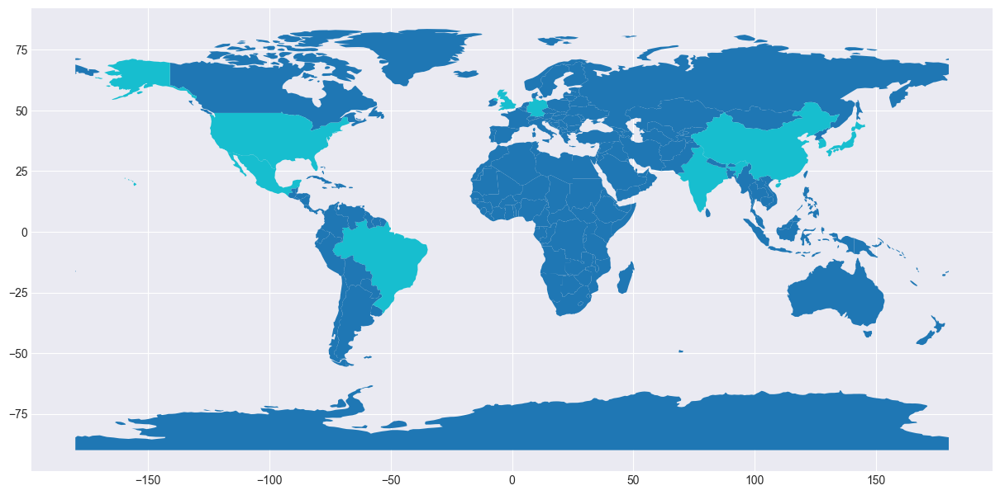

In [55]:
spatial_df.plot(column=spatial_df['ISO_A2'].isin(Countries))

### 1.1 General information about datasets

In [56]:
# trends df
trends_df.info

<bound method DataFrame.info of              date country         keyword  interest
0      2020-10-11      BR         Bitcoin         9
1      2020-10-18      BR         Bitcoin        13
2      2020-10-25      BR         Bitcoin        13
3      2020-11-01      BR         Bitcoin        16
4      2020-11-08      BR         Bitcoin        15
...           ...     ...             ...       ...
15655  2025-09-07      US  Cryptocurrency         8
15656  2025-09-14      US  Cryptocurrency        10
15657  2025-09-21      US  Cryptocurrency        11
15658  2025-09-28      US  Cryptocurrency         9
15659  2025-10-05      US  Cryptocurrency         7

[15660 rows x 4 columns]>

In [57]:
temporal_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1827 entries, 2020-10-15 to 2025-10-15
Data columns (total 25 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ADA-USD_Open     1827 non-null   float64
 1   ADA-USD_High     1827 non-null   float64
 2   ADA-USD_Low      1827 non-null   float64
 3   ADA-USD_Close    1827 non-null   float64
 4   ADA-USD_Volume   1827 non-null   float64
 5   ETH-USD_Open     1827 non-null   float64
 6   ETH-USD_High     1827 non-null   float64
 7   ETH-USD_Low      1827 non-null   float64
 8   ETH-USD_Close    1827 non-null   float64
 9   ETH-USD_Volume   1827 non-null   float64
 10  BTC-USD_Open     1827 non-null   float64
 11  BTC-USD_High     1827 non-null   float64
 12  BTC-USD_Low      1827 non-null   float64
 13  BTC-USD_Close    1827 non-null   float64
 14  BTC-USD_Volume   1827 non-null   float64
 15  DOGE-USD_Open    1827 non-null   float64
 16  DOGE-USD_High    1827 non-null   float64
 17  DOGE

## 2 Creating a choropleth map

### 2.1 Calculating total interest per country

In [58]:
interests = {}
for country in Countries:
    temp_df = trends_df[trends_df["country"] == country]
    interest = sum(temp_df['interest'])
    interests[country] = interest

print(interests)

{'US': 13616, 'MX': 12339, 'BR': 14734, 'CN': 12209, 'JP': 20111, 'DE': 17825, 'GB': 14581, 'IN': 10270, 'KR': 19064, 'SG': 12587}


In [59]:
del interests["SG"]
numbers = []
for item in interests:
    value = interests[item]
    numbers.append(value)
Countries_2 = Countries[:-1]

In [60]:
interests_df = pd.DataFrame(data = {'ISO_A2': Countries_2, 'Interest': numbers})
interests_df

,ISO_A2,Interest
0,US,13616
1,MX,12339
2,BR,14734
3,CN,12209
4,JP,20111
5,DE,17825
6,GB,14581
7,IN,10270
8,KR,19064


In [61]:
geo_interests_df = spatial_df.merge(right=interests_df, on= 'ISO_A2', how= 'left')
geo_interests_df['Interest'] = geo_interests_df['Interest'].fillna(0)
geo_interests_df

,featurecla,scalerank,LABELRANK,SOVEREIGNT,SOV_A3,ADM0_DIF,LEVEL,TYPE,TLC,ADMIN,...,FCLASS_ID,FCLASS_PL,FCLASS_GR,FCLASS_IT,FCLASS_NL,FCLASS_SE,FCLASS_BD,FCLASS_UA,geometry,Interest
0,Admin-0 country,1,6,Fiji,FJI,0,2,Sovereign country,1,Fiji,...,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((180 -16.06713, 180 -16.55522, ...",0.0
1,Admin-0 country,1,3,United Republic of Tanzania,TZA,0,2,Sovereign country,1,United Republic of Tanzania,...,None,None,None,None,None,None,None,None,"POLYGON ((33.90371 -0.95, 34.07262 -1.05982, 3...",0.0
2,Admin-0 country,1,7,Western Sahara,SAH,0,2,Indeterminate,1,Western Sahara,...,Unrecognized,Unrecognized,None,None,Unrecognized,None,None,None,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948...",0.0
3,Admin-0 country,1,2,Canada,CAN,0,2,Sovereign country,1,Canada,...,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((-122.84 49, -122.97421 49.0025...",0.0
4,Admin-0 country,1,2,United States of America,US1,1,2,Country,1,United States of America,...,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((-122.84 49, -120 49, -117.0312...",13616.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
172,Admin-0 country,1,5,Republic of Serbia,SRB,0,2,Sovereign country,1,Republic of Serbia,...,None,None,None,None,None,None,None,None,"POLYGON ((18.82982 45.90887, 18.82984 45.90888...",0.0
173,Admin-0 country,1,6,Montenegro,MNE,0,2,Sovereign country,1,Montenegro,...,None,None,None,None,None,None,None,None,"POLYGON ((20.0707 42.58863, 19.80161 42.50009,...",0.0
174,Admin-0 country,1,6,Kosovo,KOS,0,2,Disputed,1,Kosovo,...,Unrecognized,Admin-0 country,Unrecognized,Admin-0 country,Admin-0 country,Admin-0 country,Admin-0 country,Unrecognized,"POLYGON ((20.59025 41.85541, 20.52295 42.21787...",0.0
175,Admin-0 country,1,5,Trinidad and Tobago,TTO,0,2,Sovereign country,1,Trinidad and Tobago,...,None,None,None,None,None,None,None,None,"POLYGON ((-61.68 10.76, -61.105 10.89, -60.895...",0.0


<Axes: >

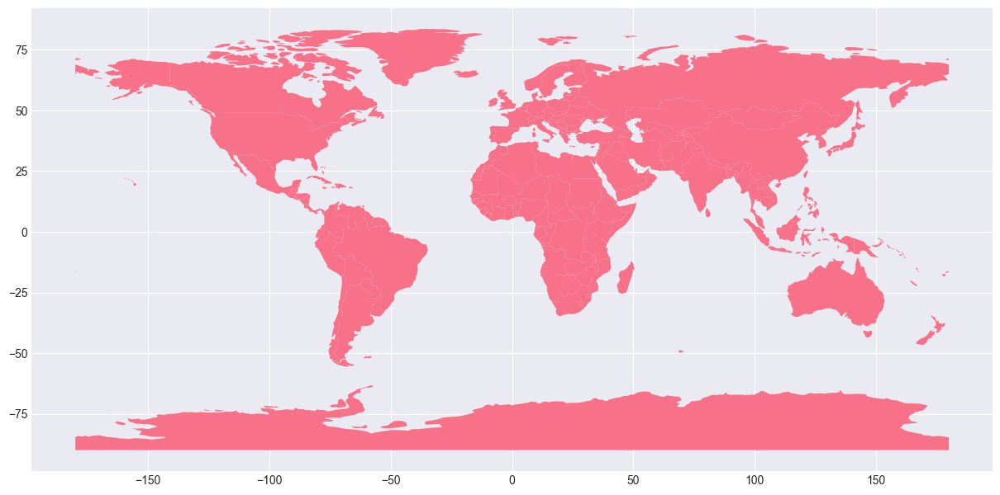

In [62]:
geo_interests_df.plot()

### 2.2 Plotting the choropleth map

In [63]:
import plotly.express as px

# 1. Define the color scale and title
title_text = "Global Crypto Engagement (2020-2025) by Total Search Interest"
color_scale = 'Sunset' # A sequential, vivid color scale

# 2. Create the interactive choropleth map
fig = px.choropleth_map(
    # Use the merged GeoDataFrame
    geo_interests_df, 
    # Use the geometry column for the shapes
    geojson=geo_interests_df.geometry, 
    # The column to drive the color (Total Interest)
    color='Interest',
    # The administrative name for tooltips/hover info
    locations=geo_interests_df.index, 
    # Must match the index for the geojson argument
    featureidkey=geo_interests_df.index.name, 
    # Set color properties
    color_continuous_scale=color_scale,
    # Set initial map view properties
    map_style="carto-positron", # A clean, light map background
    center={"lat": 30, "lon": 0},  # Centered near the world map middle
    zoom=0.8,
    # Set descriptive labels for the color bar and tooltips
    labels={'Interest': 'Total Search Interest Score'},
    # Set the title
    title=title_text
)

# 3. Customize the layout and tooltips
fig.update_layout(
    margin={"r":0,"t":50,"l":0,"b":0},
    coloraxis_colorbar=dict(
        title='Interest Score',
        tickformat=',.0f'
    )
)

# To add the "Top Keyword" to the tooltip, a custom hover template is needed.
# Since this requires further data aggregation (finding the top keyword per country),
# we'll keep the simple, standard tooltip for now and add the feature in a later step
# for clean incremental development.

# fig.show() 
print("\nInteractive Choropleth Map generated using Plotly Express.")
print("Run fig.show() to view the map in your environment.")


Interactive Choropleth Map generated using Plotly Express.
Run fig.show() to view the map in your environment.


In [64]:
fig.show()

## 3 Creating a time series by region chart

### 3.1 Calculating temporal aggregation

In [65]:
# 1. Map country names to ISO codes for easier plotting/labeling
iso_to_name = {'US': 'US', 'MX': 'MX', 'BR': 'BR', 'CN': 'CN', 
               'JP': 'JP', 'DE': 'DE', 'GB': 'GB', 'IN': 'IN', 
               'KR': 'KR', 'SG': 'SG'}
name_to_iso = {v: k for k, v in iso_to_name.items()}

trends_df['ISO_A2'] = trends_df['country'].map(name_to_iso)

# 2. Aggregate the weekly interest across all keywords for each country
# We group by the date and the country's ISO code
regional_temporal_df = trends_df.groupby(['date', 'ISO_A2'])['interest'].sum().reset_index()
regional_temporal_df.rename(columns={'interest': 'Total_Weekly_Interest'}, inplace=True)

print("Regional Temporal Data Head:")
print(regional_temporal_df.head())

btc_price_series = temporal_df['BTC-USD_Close']

# Making sure the daily indexes are datetime objects
btc_price_df = btc_price_series.to_frame(name='BTC_Close')
btc_price_df.index = pd.to_datetime(btc_price_df.index)

# Resample the daily price data to weekly (taking the last price of the week)
weekly_btc_price = btc_price_df['BTC_Close'].resample('W-SUN').last().reset_index()
weekly_btc_price.rename(columns={'Date': 'weekly_date'}, inplace=True)

# Align the trend data date to the weekly date index
regional_temporal_df['date'] = pd.to_datetime(regional_temporal_df['date'])
# The trends data is already weekly, so the dates should match
# We'll need a common date column for the merge. Assuming the trend date is a weekly end date.
regional_temporal_df = regional_temporal_df.merge(
    weekly_btc_price, 
    left_on='date', 
    right_on='weekly_date', 
    how='left'
)
regional_temporal_df.drop(columns=['weekly_date'], inplace=True)

print("\nMerged Temporal Data with BTC Price Head:")
print(regional_temporal_df.head())
regional_temporal_df

Regional Temporal Data Head:
         date ISO_A2  Total_Weekly_Interest
0  2020-10-11     BR                     16
1  2020-10-11     CN                     16
2  2020-10-11     DE                     25
3  2020-10-11     GB                     23
4  2020-10-11     IN                     11

Merged Temporal Data with BTC Price Head:
        date ISO_A2  Total_Weekly_Interest  BTC_Close
0 2020-10-11     BR                     16        NaN
1 2020-10-11     CN                     16        NaN
2 2020-10-11     DE                     25        NaN
3 2020-10-11     GB                     23        NaN
4 2020-10-11     IN                     11        NaN


,date,ISO_A2,Total_Weekly_Interest,BTC_Close
0,2020-10-11,BR,16,NaN
1,2020-10-11,CN,16,NaN
2,2020-10-11,DE,25,NaN
3,2020-10-11,GB,23,NaN
4,2020-10-11,IN,11,NaN
...,...,...,...,...
2605,2025-10-05,JP,72,123513.476562
2606,2025-10-05,KR,48,123513.476562
2607,2025-10-05,MX,32,123513.476562
2608,2025-10-05,SG,38,123513.476562


### 3.2 Calculating temporal aggregation for closing price

NOTE: Log returns are preferred for time series analysis as they are additive over time and are more symmetrically distributed than simple returns.

In [66]:
# Assuming temporal_df has the multi-index structure: (Ticker, Price) -> Date
# 1. Isolate Close Prices for key volatile assets
close_prices = temporal_df[['BTC-USD_Close', 'ETH-USD_Close', 'ADA-USD_Close', 'XRP-USD_Close', 'DOGE-USD_Close']]

# Rename columns to just the Ticker for cleaner plotting labels
close_prices.columns = ['BTC-USD', 'ETH-USD', 'ADA-USD', 'XRP-USD', 'DOGE-USD']

# 2. Calculate Daily Log Returns
log_returns = np.log(close_prices / close_prices.shift(1))

# 3. Calculate Cumulative Performance (start at 100 for better visualization)
# Cumulative Return Index: 100 * exp(Cumulative Sum of Log Returns)
cumulative_performance = 100 * np.exp(log_returns.cumsum())
cumulative_performance.dropna(inplace=True)

print("Cumulative Performance Data Head (Index reflects growth starting at 100):")
print(cumulative_performance.head())

Cumulative Performance Data Head (Index reflects growth starting at 100):
               BTC-USD     ETH-USD     ADA-USD     XRP-USD    DOGE-USD
Date                                                                  
2020-10-16   98.493073   97.029256   97.588977   97.764905  100.732748
2020-10-17   98.806056   97.725237   99.502044   97.963326   99.537221
2020-10-18   99.895695  100.204495  100.706148   98.489472   99.730040
2020-10-19  102.145976  100.660704  101.914946  100.009761   99.884303
2020-10-20  103.662223   97.799679   96.116664   99.037568  100.308525


In [67]:
import plotly.express as px

# 1. Melt the DataFrame to long format for Plotly Express
performance_melted = cumulative_performance.reset_index().melt(
    id_vars='Date',
    value_vars=['BTC-USD', 'ETH-USD', 'ADA-USD', 'XRP-USD', 'DOGE-USD'],
    var_name='Ticker',
    value_name='Cumulative_Return_Index'
)

# 2. Create the interactive line chart
fig2 = px.line(
    performance_melted,
    x='Date',
    y='Cumulative_Return_Index',
    color='Ticker',
    line_dash='Ticker',
    title="Comparative 5-Year Cumulative Performance (Normalized to 100)",
    labels={
        "Cumulative_Return_Index": "Performance Index (Start=100)",
        "Date": "Date",
        "Ticker": "Cryptocurrency"
    },
    hover_data={
        "Cumulative_Return_Index": ':.2f',
        "Ticker": True
    }
)

# 3. Customize the layout
fig2.update_layout(
    yaxis_title="Normalized Growth Index (Base 100)",
    legend_title="Asset"
)

fig2.show()
print("\nInteractive Time Series Chart for Comparative Crypto Performance successfully generated.")# 


Interactive Time Series Chart for Comparative Crypto Performance successfully generated.


In [68]:
import plotly.graph_objects as go

# --- Normalization Function ---
def normalize_series(series):
    """Normalizes a series to a 0-100 scale."""
    min_val = series.min()
    max_val = series.max()
    # Avoid division by zero if all values are the same
    if max_val == min_val:
        return series * 0 
    return ((series - min_val) / (max_val - min_val)) * 100

# --- Apply Normalization ---

# 1. Normalize Interest (must be done PER COUNTRY)
# Apply the normalization function to 'Total_Weekly_Interest', grouped by country
regional_temporal_df['Norm_Interest'] = regional_temporal_df.groupby('ISO_A2')['Total_Weekly_Interest'].transform(normalize_series)

# 2. Normalize BTC Price (must be done across the entire dataset)
# Since the BTC price is the global context, normalize it across all dates
regional_temporal_df['Norm_BTC_Price'] = normalize_series(regional_temporal_df['BTC_Close'])

print("Data normalization complete. New columns added:")
print(regional_temporal_df[['date', 'ISO_A2', 'Norm_Interest', 'Norm_BTC_Price']].head())

# =============== Plotting the time series chart ===================== #

# Define the country you want to focus on initially (e.g., United States)
selected_country_iso = 'MX' 

# Filter the aggregated data for the selected country
country_data = regional_temporal_df[regional_temporal_df['ISO_A2'] == selected_country_iso].copy()

# Ensure the BTC price is unique for the context line
btc_price_context = country_data[['date', 'Norm_BTC_Price']].drop_duplicates()

# 1. Create the figure object
fig2 = go.Figure()

# 2. Add the Normalized BTC Price (Context) - Primary Y-Axis (Left)
fig2.add_trace(
    go.Scatter(
        x=btc_price_context['date'], 
        y=btc_price_context['Norm_BTC_Price'], 
        name='Normalized BTC Price',
        line=dict(color='gray', dash='dash'),
        yaxis='y1', # Use the primary y-axis
        hovertemplate='Date: %{x}<br>BTC Price Index: %{y:.2f}<extra></extra>'
    )
)

# 3. Add the Normalized Regional Interest - Secondary Y-Axis (Right)
fig2.add_trace(
    go.Scatter(
        x=country_data['date'], 
        y=country_data['Norm_Interest'], 
        name=f'{selected_country_iso} Total Interest',
        line=dict(color='deepskyblue', width=3),
        yaxis='y2', # Use the secondary y-axis
        hovertemplate='Date: %{x}<br>Interest Index: %{y:.2f}<extra></extra>'
    )
)

# 4. Customize the Layout with Dual Y-Axes
fig2.update_layout(
    title=f"Normalized Weekly Crypto Interest in {selected_country_iso} vs. Global BTC Price (2020-2025) 📈",
    xaxis_title="Date",
    
    # Primary Y-Axis (Left) for BTC Price
    yaxis=dict(
        title="BTC Price Index (0-100)",
        tickfont=dict(color="gray")
    ),
    
    # Secondary Y-Axis (Right) for Interest
    yaxis2=dict(
        title=f"{selected_country_iso} Total Interest Index (0-100)",
        tickfont=dict(color="deepskyblue"),
        overlaying="y",  # Overlay on the primary y-axis
        side="right",    # Place on the right side
    ),
    
    # General layout settings
    legend=dict(x=0.01, y=0.99),
    hovermode="x unified"
)

fig2.show()
print(f"\nInteractive Dual-Axis Time Series Chart for {selected_country_iso} successfully generated.")
print("To change the country focus, modify the 'selected_country_iso' variable at the beginning of this block.")

Data normalization complete. New columns added:
        date ISO_A2  Norm_Interest  Norm_BTC_Price
0 2020-10-11     BR       0.000000             NaN
1 2020-10-11     CN       3.539823             NaN
2 2020-10-11     DE       0.000000             NaN
3 2020-10-11     GB       0.423729             NaN
4 2020-10-11     IN       0.000000             NaN



Interactive Dual-Axis Time Series Chart for MX successfully generated.
To change the country focus, modify the 'selected_country_iso' variable at the beginning of this block.


## 4 Spatiotemporal analysis

In [69]:
rolling_volatility['BTC-USD']

,Date,Returns,Vol_7d,Vol_30d,Vol_90d
1,2020-10-16,-1.506927,NaN,NaN,NaN
2,2020-10-17,0.317772,NaN,NaN,NaN
3,2020-10-18,1.102806,NaN,NaN,NaN
4,2020-10-19,2.252631,NaN,NaN,NaN
5,2020-10-20,1.484392,NaN,NaN,NaN
...,...,...,...,...,...
1822,2025-10-11,-2.125600,2.972056,2.045108,1.707257
1823,2025-10-12,3.936437,3.529869,2.173018,1.757299
1824,2025-10-13,0.087968,3.462208,2.172946,1.747957
1825,2025-10-14,-1.867263,3.415330,2.198285,1.756594


In [70]:
vol_stats_df

,Crypto,Vol_Media,Vol_Mediana,Vol_Min,Vol_Max,Vol_Std,Coef_Var
2,DOGE-USD,6.543339,4.651434,1.051731,67.538135,8.630207,131.893019
1,XRP-USD,4.927147,3.874155,1.583341,14.451864,3.040542,61.709999
3,ADA-USD,4.728191,4.159372,1.223501,15.033164,2.301383,48.673639
0,ETH-USD,3.875495,3.670327,0.805873,10.490903,1.496431,38.612630
4,BTC-USD,2.922324,2.789395,0.888669,6.230881,1.058388,36.217329


In [71]:
vol_corr_df

,Date,ETH-USD,XRP-USD,DOGE-USD,ADA-USD,BTC-USD
0,2020-10-16,NaN,NaN,NaN,NaN,NaN
1,2020-10-17,NaN,NaN,NaN,NaN,NaN
2,2020-10-18,NaN,NaN,NaN,NaN,NaN
3,2020-10-19,NaN,NaN,NaN,NaN,NaN
4,2020-10-20,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...
1821,2025-10-11,3.700020,3.715621,5.844843,5.103102,2.045108
1822,2025-10-12,4.113932,3.894903,6.111665,5.519673,2.173018
1823,2025-10-13,4.132531,3.940780,6.053939,5.573264,2.172946
1824,2025-10-14,4.155864,3.965879,6.066268,5.565735,2.198285


In [72]:
vol_data

,Date,Returns,Vol_7d,Vol_30d,Vol_90d
1,2020-10-16,-1.506927,NaN,NaN,NaN
2,2020-10-17,0.317772,NaN,NaN,NaN
3,2020-10-18,1.102806,NaN,NaN,NaN
4,2020-10-19,2.252631,NaN,NaN,NaN
5,2020-10-20,1.484392,NaN,NaN,NaN
...,...,...,...,...,...
1822,2025-10-11,-2.125600,2.972056,2.045108,1.707257
1823,2025-10-12,3.936437,3.529869,2.173018,1.757299
1824,2025-10-13,0.087968,3.462208,2.172946,1.747957
1825,2025-10-14,-1.867263,3.415330,2.198285,1.756594


In [77]:
# Define the assets for calculation
volatile_cryptos = ['Bitcoin', 'Ripple', 'Cardano', 'Dogecoin']
stablecoin_crypto = 'Bitcoin'
iso_to_name = {'US': 'US', 'MX': 'MX', 'BR': 'BR', 'CN': 'CN', 
               'JP': 'JP', 'DE': 'DE', 'GB': 'GB', 'IN': 'IN', 
               'KR': 'KR', 'SG': 'SG'}


# --- 2. DATA PREPARATION: CALCULATE INTEREST METRICS PER COUNTRY ---

# Filter trends_df to only include the focus countries and cryptos
focus_countries = list(iso_to_name.values())
focus_trends = trends_df[trends_df['country'].isin(focus_countries)].copy()

# Add ISO_A2 column
name_to_iso = {v: k for k, v in iso_to_name.items()}
focus_trends['ISO_A2'] = focus_trends['country'].map(name_to_iso)

# Calculate total interest, and pivot to get keyword totals per country
interest_pivot = focus_trends.groupby(['ISO_A2', 'keyword'])['interest'].sum().unstack(fill_value=0)
interest_pivot['Total_Interest'] = interest_pivot.sum(axis=1)

# Calculate interest in volatile assets (sum of all non-stablecoin keywords)
volatile_cols = [k for k in interest_pivot.columns if k in volatile_cryptos]
interest_pivot['Volatile_Interest'] = interest_pivot[volatile_cols].sum(axis=1)

# Calculate the key metric: Ratio of Volatile Interest to Total Interest (our risk proxy)
interest_pivot['Volatile_Ratio'] = interest_pivot['Volatile_Interest'] / interest_pivot['Total_Interest']
interest_pivot['Volatile_Ratio'] = interest_pivot['Volatile_Ratio'] * 100 # Express as percentage

# Final DataFrame for the correlation plot
correlation_df = interest_pivot[['Total_Interest', 'Volatile_Ratio']].reset_index()


# --- 3. EXTRACT GLOBAL VOLATILITY CONTEXT ---

# Extract the average volatility for the benchmark asset (BTC-USD) from vol_stats_df
btc_volatility_stats = vol_stats_df[vol_stats_df['Crypto'] == 'BTC-USD']

# Assuming the average volatility column is named 'Vol_Media'
global_btc_vol_media = btc_volatility_stats['Vol_Media'].iloc[0]


# --- 4. VISUALIZATION: INTERACTIVE SCATTER PLOT ---

fig4 = px.scatter(
    correlation_df,
    x='Total_Interest',
    y='Volatile_Ratio',
    color='ISO_A2',
    text='ISO_A2', # Label points with ISO codes
    size='Total_Interest', # Use size to reinforce total market engagement
    title="Geographic Crypto Engagement: Total Interest vs. Volatile Asset Preference",
    labels={
        "Total_Interest": "Total Cumulative Search Interest (All Assets)",
        "Volatile_Ratio": "Volatile Asset Interest Ratio (%)",
        "ISO_A2": "Country"
    },
    template="plotly_white"
)

# Customize point appearance and hover info
fig4.update_traces(
    textposition='top center', 
    marker=dict(opacity=0.8, line=dict(width=1, color='DarkSlateGrey')),
    hovertemplate="<b>%{text}</b><br>Total Interest: %{x}<br>Volatile Ratio: %{y:.2f}%<extra></extra>"
)

# Add a Global Volatility Context Annotation (This is the "volatility" part of the correlation)
fig4.add_annotation(
    x=correlation_df['Total_Interest'].min() + (correlation_df['Total_Interest'].max() - correlation_df['Total_Interest'].min()) * 0.05, 
    y=correlation_df['Volatile_Ratio'].max(),
    text=f"Global BTC Average Volatility (5Y): {global_btc_vol_media:.2f} (Context)",
    showarrow=False,
    xref="x", yref="y",
    xanchor="left", yanchor="top",
    bgcolor="rgba(255, 255, 255, 0.8)",
    bordercolor="lightgrey",
    borderwidth=1,
    font=dict(size=11, color="firebrick")
)

fig4.update_layout(
    xaxis_title="Total Engagement Score (Search Volume)",
    yaxis_title="Preference for Volatile Assets (BTC, ETH, ADA, DOGE)",
    legend_title="Country (ISO)",
    hovermode="closest"
)

fig4.show()

The chart connects a country's engagement volume (X-axis) with its market risk preference (Y-axis), using global market volatility as a necessary annotation.

BTC-USD was selected as benchmark since its volatility is the benchmark for the entire cryptocurrency market. When BTC volatility changes, the volatility of ETH and SOL (and most other assets) follows suit. Using BTC's average volatility provides a sufficient and non-redundant measure of the overall market environment.

The analysis is focused on regional differences (the countries on the X and Y axes). The global volatility measure is included as a context, not as a primary variable. Including five different volatility numbers (one for each crypto) would clutter the annotation without adding significant analytical value, as they are highly correlated with BTC's volatility.

In [74]:
from statsmodels.tsa.stattools import ccf
temporal_df.index = pd.to_datetime(temporal_df.index)

# 2.1 Calculate Daily Log Returns for BTC
btc_close_prices = temporal_df['BTC-USD_Close']
# Ensure data is sorted by date index
btc_close_prices = btc_close_prices.sort_index()

# Calculate daily log returns
daily_log_returns = np.log(btc_close_prices / btc_close_prices.shift(1))
daily_log_returns.dropna(inplace=True)

# 2.2 Aggregate Daily Returns to Weekly Volatility (Standard Deviation)
# Calculate weekly realized volatility (standard deviation of returns within the week)
weekly_volatility = daily_log_returns.resample('W').std()
weekly_volatility.name = 'Weekly_Volatility'
weekly_volatility.dropna(inplace=True)


# --- 3. PREPARE INTEREST TIME SERIES (X) ---

# 3.1 Aggregate Global Weekly Interest (Sum of all 9 focus countries and all 5 cryptos)
# Group by date and sum the 'interest' column
global_weekly_interest = trends_df.groupby('date')['interest'].sum()
global_weekly_interest.index = pd.to_datetime(global_weekly_interest.index)
global_weekly_interest.name = 'Global_Interest'
global_weekly_interest.sort_index(inplace=True)


# --- 4. ALIGN AND SYNCHRONIZE DATA ---

# Merge the two series on their weekly dates
combined_df = pd.DataFrame(global_weekly_interest).merge(
    pd.DataFrame(weekly_volatility),
    left_index=True,
    right_index=True,
    how='inner' # Only keep dates where both series have data
)
combined_df.dropna(inplace=True)


# --- 5. ACHIEVE STATIONARITY (CRUCIAL FOR CCF) ---

# Cross-correlation requires stationary time series (differencing is standard practice)
# We will take the week-over-week percentage change for both series.

# Series X (Interest): % Change
X_series = combined_df['Global_Interest'].pct_change().dropna()
# Series Y (Volatility): % Change
Y_series = combined_df['Weekly_Volatility'].pct_change().dropna()

# Final synchronization after differencing
min_len = min(len(X_series), len(Y_series))
X_ccf = X_series[-min_len:]
Y_ccf = Y_series[-min_len:]


# --- 6. CALCULATE CROSS-CORRELATION FUNCTION (CCF) ---

# We'll test lags up to +/- 52 weeks (one year)
max_lag = 52
ccf_result = ccf(X_ccf, Y_ccf, adjusted=False, nlags=max_lag)

# Create lag index: 0 is contemporaneous, negative lags mean X leads Y, positive lags mean Y leads X
lags = np.arange(-max_lag, max_lag + 1)
# CCF output is only for positive lags including 0, we need to manually create the full array
# The negative lags are calculated by inverting the order of positive lags (excluding lag 0)
ccf_full = np.concatenate((ccf_result[::-1][:-1], ccf_result))

# --- 7. VISUALIZATION (Plotly Bar Chart) ---

# Calculate significance bounds (approximate 95% confidence interval)
N = len(X_ccf) # Number of observations
confidence_bound = 1.96 / np.sqrt(N) # 95% Confidence Interval for White Noise

fig4 = go.Figure()

# Plot the CCF results as a bar chart
fig4.add_trace(go.Scatter(
    x=lags, 
    y=ccf_full, 
    name='Cross-Correlation',
    marker_color='#1f77b4'
))

# Plot the 95% significance bounds
fig4.add_trace(go.Scatter(
    x=lags, y=np.full_like(lags, confidence_bound),
    mode='lines', line=dict(color='red', dash='dash'),
    name='95% Confidence Bound'
))
fig4.add_trace(go.Scatter(
    x=lags, y=np.full_like(lags, -confidence_bound),
    mode='lines', line=dict(color='red', dash='dash'),
    showlegend=False
))

# Add lag interpretation areas
fig4.add_vrect(x0=-max_lag, x1=-0.5, fillcolor="green", opacity=0.1, layer="below", line_width=0, 
              annotation_text="Interest Predicts Volatility", annotation_position="top left")
fig4.add_vrect(x0=0.5, x1=max_lag, fillcolor="orange", opacity=0.1, layer="below", line_width=0,
              annotation_text="Volatility Predicts Interest", annotation_position="top right")
fig4.add_vrect(x0=-0.5, x1=0.5, fillcolor="gray", opacity=0.1, layer="below", line_width=0,
              annotation_text="Contemporaneous", annotation_position="bottom right")


fig4.update_layout(
    title='Cross-Correlation: Global Interest Change vs. BTC Volatility Change',
    xaxis_title='Lag (Weeks)',
    yaxis_title='Cross-Correlation Coefficient',
    xaxis=dict(tickmode='linear', tick0=0, dtick=4),
    template="plotly_white",
    hovermode="x unified"
)

fig4.show()
print("\nCross-Correlation Analysis (Lead/Lag) visualization generated successfully.")
print("A bar extending above or below the red dashed lines indicates a statistically significant relationship.")
print("Interpretation:")
print("Negative Lag (e.g., -4): Global Interest (4 weeks ago) predicts current BTC Volatility.")
print("Positive Lag (e.g., +4): BTC Volatility (4 weeks ago) predicts current Global Interest.")


Cross-Correlation Analysis (Lead/Lag) visualization generated successfully.
A bar extending above or below the red dashed lines indicates a statistically significant relationship.
Interpretation:
Negative Lag (e.g., -4): Global Interest (4 weeks ago) predicts current BTC Volatility.
Positive Lag (e.g., +4): BTC Volatility (4 weeks ago) predicts current Global Interest.


Strongest correlation (0.222837): This peak is statistically significant if it extends above the red dashed line (the 95% confidence bound). If it does, it tells you that the two series exhibit their strongest, most reliable relationship at the specific lag where this peak occurs.
Lag at 0: Since a correlation is only zero if the two series are perfectly independent, the value −0.0138 means there is an extremely weak (but not independent relationship) almost zero, negative correlation between the change in Global Interest and the simultaneous change in BTC Volatility in the same week. In other words, this means there is essentially no instantaneous (same-week) linear relationship between a sudden change in global search interest and a sudden change in Bitcoin volatility.
- ### Values < 0: Interest today is correlated with a spike in Volatility sometime in the future.
- ### Values > 0: Volatility today is correlated with a spike in Interest sometime in the future.

## 7. Exporting dataframes to JSON

The JSON files will be used by web the microservice

In [84]:
interests_df.to_json('./data/interests.json', orient= 'records')
vol_stats_df.to_json('./data/vol_stats.json', orient= 'records')
combined_df.to_json('./data/ccf_full.json', orient= 'records')
correlation_df.to_json('./data/correlation.json', orient= 'records')
acf_summary_df.to_json('./data/acf_returns_squared.json', orient= 'records')